# Capstone Project
## Notebook 2: Exploratory Data Analysis, Data Preprocessing, Modeling

- Tia Plagata

- https://github.com/tiaplagata/capstone-project

- tiaplagata@gmail.com

In [1]:
# Import Statements

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import string
import regex as re
import spacy

from nltk.corpus import stopwords
# nltk.download('stopwords')
# nltk.download('punkt')
from nltk import word_tokenize
from nltk import FreqDist

import warnings
warnings.filterwarnings('ignore')

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB, GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import recall_score, confusion_matrix, classification_report
from sklearn.utils import class_weight
from sklearn.pipeline import Pipeline

from PIL import Image
from wordcloud import WordCloud
from textwrap import wrap

import pickle

In [2]:
# Read in the DataFrame I created in the Data Collection notebook 
df = pd.read_csv('/Users/tiaplagata/Documents/Flatiron/capstone-project/Data/cities_df', index_col=0)
df.head()

,Attraction,City
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom"
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom"
2,Ghost Bus Tour of London,"London, United Kingdom"
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom"
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom"


## Explore/clean the data
- Decide whether or not to get rid of duplicates
- Check out the class imbalance
- *No need to worry about null values because I scraped this dataset myself*

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 28379 entries, 0 to 3693
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Attraction  28379 non-null  object
 1   City        28379 non-null  object
dtypes: object(2)
memory usage: 665.1+ KB


In [4]:
df.describe()

,Attraction,City
count,28379,28379
unique,27466,12
top,Desert Safari Dubai,"Rome, Italy"
freq,15,5000


In [5]:
df.shape

(28379, 2)

In [6]:
#No null values because I scraped everything myself. Just to double-check:
df.isna().sum()

Attraction    0
City          0
dtype: int64

### Duplicates

In [7]:
df.duplicated().sum()

846

In [8]:
# Look at duplicates in one city
df[(df.duplicated()==True) & (df['City']=='London, United Kingdom')]

,Attraction,City
185,"Windsor Castle, Stonehenge, and Oxford Day Tri...","London, United Kingdom"
241,Jack the Ripper Walking Tour in London,"London, United Kingdom"
259,British Museum Guided Tour,"London, United Kingdom"
618,Private Transfer from Heathrow Airport to London,"London, United Kingdom"
704,Oxford City Full-Day Private Tour from London,"London, United Kingdom"
705,Bath and Stonehenge Full-Day Private Tour from...,"London, United Kingdom"
706,Full-Day Private Guided Tour of Cambridge,"London, United Kingdom"
716,Full-Day Private Tour of Brighton,"London, United Kingdom"
900,PRIVATE Jack the Ripper Ghost Walking Tour in ...,"London, United Kingdom"
990,London to Southampton Cruise Terminals Private...,"London, United Kingdom"


In [9]:
df[df['Attraction']=='Oxford City Full-Day Private Tour from London']

,Attraction,City
431,Oxford City Full-Day Private Tour from London,"London, United Kingdom"
704,Oxford City Full-Day Private Tour from London,"London, United Kingdom"


In [10]:
# What about the top attraction?
df[df['Attraction']=='Desert Safari Dubai']

,Attraction,City
414,Desert Safari Dubai,"Dubai, United Arab Emirates"
478,Desert Safari Dubai,"Dubai, United Arab Emirates"
811,Desert Safari Dubai,"Dubai, United Arab Emirates"
974,Desert Safari Dubai,"Dubai, United Arab Emirates"
998,Desert Safari Dubai,"Dubai, United Arab Emirates"
1001,Desert Safari Dubai,"Dubai, United Arab Emirates"
1689,Desert Safari Dubai,"Dubai, United Arab Emirates"
1718,Desert Safari Dubai,"Dubai, United Arab Emirates"
1722,Desert Safari Dubai,"Dubai, United Arab Emirates"
1944,Desert Safari Dubai,"Dubai, United Arab Emirates"


**Clearly, I need to remove duplicates here, because there are some exact duplicates for certain cities.**

In [11]:
df = df.drop_duplicates()

In [12]:
# df.to_csv('/Users/tiaplagata/Documents/Flatiron/capstone-project/Data/cities_cleaned')

### Class Imbalance

In [13]:
display(df.City.unique())
print('Total Unique Cities:', len(df.City.unique()))

array(['London, United Kingdom', 'Paris, France', 'Crete, Greece',
       'Bali, Indonesia', 'Rome, Italy', 'Phuket, Thailand',
       'Sicily, Italy', 'Majorca, Balearic Islands', 'Barcelona, Spain',
       'Istanbul, Turkey', 'Goa, India', 'Dubai, United Arab Emirates'],
      dtype=object)

Total Unique Cities: 12


In [14]:
df.City.value_counts(normalize=True)

Bali, Indonesia                0.177823
Rome, Italy                    0.174990
Dubai, United Arab Emirates    0.123597
London, United Kingdom         0.099626
Paris, France                  0.096938
Istanbul, Turkey               0.081248
Sicily, Italy                  0.071986
Barcelona, Spain               0.066502
Phuket, Thailand               0.041260
Crete, Greece                  0.037010
Majorca, Balearic Islands      0.016489
Goa, India                     0.012530
Name: City, dtype: float64

In [15]:
cities = df.groupby('City').count()

In [16]:
cities.reset_index(inplace=True)

In [17]:
sorted_cities = cities.sort_values(by='Attraction', ascending=False)
sorted_cities

,City,Attraction
0,"Bali, Indonesia",4896
10,"Rome, Italy",4818
3,"Dubai, United Arab Emirates",3403
6,"London, United Kingdom",2743
8,"Paris, France",2669
5,"Istanbul, Turkey",2237
11,"Sicily, Italy",1982
1,"Barcelona, Spain",1831
9,"Phuket, Thailand",1136
2,"Crete, Greece",1019


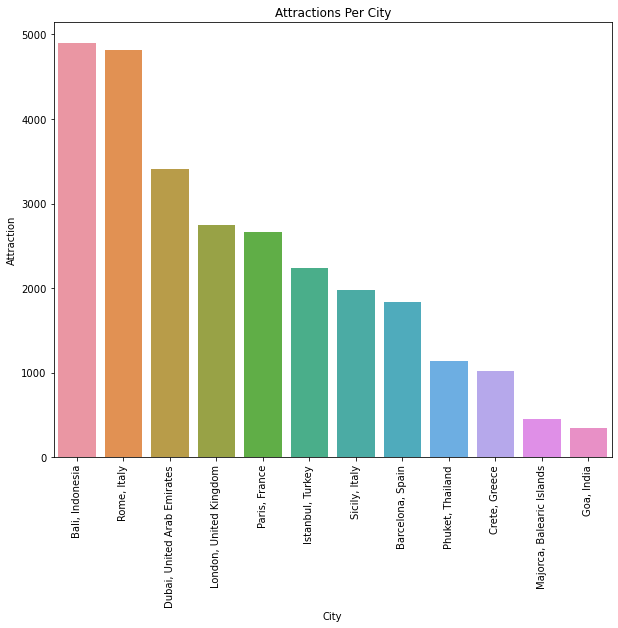

In [18]:
# Plot the class imbalance
plt.figure(figsize=(10,8))
sns.barplot(x='City', y='Attraction', data=sorted_cities)
plt.title('Attractions Per City')
plt.xticks(rotation=90)
plt.show()

**This will likely be an issue when modeling, so I will try to use class weights to fix this problem.**

## Text Cleaning & Preprocessing & More Exploration
- Remove punctuation and numbers
- Lowercase everything
- Remove stopwords
- Create a document term matrix grouped by city 
    - count vectorization
    - tf-idf vectorization
    - bi-grams
- Visualize most frequent words
    - word clouds
    - bar plot/histogram

In [19]:
# Create a list of stopwords
stopwords_list = stopwords.words('english')
stopwords_list += list(string.punctuation)

In [20]:
# Preview the list
stopwords_list[:10]

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're"]

In [21]:
# Lowercase all words in each corpus
df['cleaned'] = df['Attraction'].apply(lambda x: x.lower())
df.head()

,Attraction,City,cleaned
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hop-on hop-off tour and river c...
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom",the blood and tears walk: serial killers and l...


In [22]:
# Remove commas, hyphens, colons, and other punctuation
df['cleaned'] = df['cleaned'].apply(lambda x: re.sub('[%s]' % re.escape(string.punctuation), '', x))
df.head()

,Attraction,City,cleaned
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hopon hopoff tour and river cru...
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom",the blood and tears walk serial killers and lo...


In [23]:
# Use regex to get rid of numbers 
df['cleaned'] = df['cleaned'].apply(lambda x: re.sub('\w*\d\w*','', x))
df.head(10)

,Attraction,City,cleaned
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hopon hopoff tour and river cru...
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom",the blood and tears walk serial killers and lo...
5,London Ghost and Infamous Murders Walking Tour,"London, United Kingdom",london ghost and infamous murders walking tour
6,"Stonehenge, Windsor Castle, and Bath from London","London, United Kingdom",stonehenge windsor castle and bath from london
7,Warner Bros. Studio: The Making of Harry Potte...,"London, United Kingdom",warner bros studio the making of harry potter ...
8,"Ghosts, Ghouls & Gallows: London Virtual Tour","London, United Kingdom",ghosts ghouls gallows london virtual tour
9,High-Speed Thames River RIB Cruise in London,"London, United Kingdom",highspeed thames river rib cruise in london


In [26]:
# !python -m spacy download en

In [24]:
# Lemmatize the text using spacy
nlp = spacy.load('en')

df['lemmatized'] = df['cleaned'].apply(lambda x: ' '.join(
                                    [token.lemma_ for token in list(nlp(x)) if (token.is_stop==False)]))
df.head(10)

,Attraction,City,cleaned,lemmatized
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket,sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london,jack ripper walking tour london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london,ghost bus tour london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hopon hopoff tour and river cru...,big bus london hopon hopoff tour river cruise ...
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom",the blood and tears walk serial killers and lo...,blood tear walk serial killer london horror
5,London Ghost and Infamous Murders Walking Tour,"London, United Kingdom",london ghost and infamous murders walking tour,london ghost infamous murder walk tour
6,"Stonehenge, Windsor Castle, and Bath from London","London, United Kingdom",stonehenge windsor castle and bath from london,stonehenge windsor castle bath london
7,Warner Bros. Studio: The Making of Harry Potte...,"London, United Kingdom",warner bros studio the making of harry potter ...,warner bros studio making harry potter luxury ...
8,"Ghosts, Ghouls & Gallows: London Virtual Tour","London, United Kingdom",ghosts ghouls gallows london virtual tour,ghost ghoul gallow london virtual tour
9,High-Speed Thames River RIB Cruise in London,"London, United Kingdom",highspeed thames river rib cruise in london,highspeed thames river rib cruise london


In [26]:
# Group the corpora by city and join them
df_to_group = df[['City', 'lemmatized']]
df_grouped = df_to_group.groupby(by='City').agg(lambda x:' '.join(x))
df_grouped

,lemmatized
City,
"Bali, Indonesia",hotel hotelbali private transfer daytime bali ...
"Barcelona, Spain",interactive spanish cooking experience barcelo...
"Crete, Greece",minoans world museum cinema crete wine ol...
"Dubai, United Arab Emirates",premium red dune camel safari bbq al khayma ...
"Goa, India",fontainhas heritage walk sunset cruise paradis...
"Istanbul, Turkey",bosphorus sunset cruise luxury yacht istanbu...
"London, United Kingdom",sea life london aquarium admission ticket jack...
"Majorca, Balearic Islands",cave genova admission palma de mallorca shore ...
"Paris, France",bateaux parisiens seine river gourmet dinner ...


### Look at different vectorization strategies
- Try different vectorization strategies and visualize them with word clouds
    - count vectorization
    - tf-idf vectorization
    - bi-grams

In [27]:
# Create a document term matrix using count vectorization
# Using count vectorization (most simple way to vectorize)
cv = CountVectorizer(analyzer='word', stop_words=stopwords_list)
data = cv.fit_transform(df_grouped['lemmatized'])
df_dtm = pd.DataFrame(data.toarray(), columns=cv.get_feature_names())
df_dtm.index = df_grouped.index
df_dtm

,aal,abandon,abant,abba,abbate,abbey,abbeyprivate,abbeyst,aberfan,abian,...,تشيتا,خصوصي,دي,روما,فورميا,كاستيلوا,مدينة,من,ميرتيتوا,نقل
City,,,,,,,,,,,,,,,,,,,,,
"Bali, Indonesia",0,2,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
"Barcelona, Spain",1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Crete, Greece",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Dubai, United Arab Emirates",0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Goa, India",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Istanbul, Turkey",0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"London, United Kingdom",0,0,0,1,0,61,1,2,1,0,...,0,0,0,0,0,0,0,0,0,0
"Majorca, Balearic Islands",0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Paris, France",0,0,0,0,0,5,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [28]:
# Create a document term matrix using TF-IDF vectorization
# Might be good for classifying cities
tfidf = TfidfVectorizer(analyzer='word', stop_words=stopwords_list)
data2 = tfidf.fit_transform(df_grouped['lemmatized'])
df_dtm2 = pd.DataFrame(data2.toarray(), columns=tfidf.get_feature_names())
df_dtm2.index = df_grouped.index
df_dtm2

,aal,abandon,abant,abba,abbate,abbey,abbeyprivate,abbeyst,aberfan,abian,...,تشيتا,خصوصي,دي,روما,فورميا,كاستيلوا,مدينة,من,ميرتيتوا,نقل
City,,,,,,,,,,,,,,,,,,,,,
"Bali, Indonesia",0.000000,0.000699,0.00000,0.0000,0.000000,0.000000,0.0000,0.000,0.0000,0.000407,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Barcelona, Spain",0.000737,0.000000,0.00000,0.0000,0.000000,0.000000,0.0000,0.000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Crete, Greece",0.000000,0.000000,0.00000,0.0000,0.000000,0.000000,0.0000,0.000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Dubai, United Arab Emirates",0.000000,0.000310,0.00000,0.0000,0.000000,0.000000,0.0000,0.000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Goa, India",0.000000,0.000000,0.00000,0.0000,0.000000,0.000000,0.0000,0.000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Istanbul, Turkey",0.000000,0.000000,0.00059,0.0000,0.000000,0.000000,0.0000,0.000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"London, United Kingdom",0.000000,0.000000,0.00000,0.0005,0.000000,0.023129,0.0005,0.001,0.0005,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Majorca, Balearic Islands",0.000000,0.000000,0.00000,0.0000,0.003349,0.000000,0.0000,0.000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Paris, France",0.000000,0.000000,0.00000,0.0000,0.000000,0.002366,0.0000,0.000,0.0000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


#### Word Clouds with Count Vectorization

In [29]:
def generate_wordcloud(data, title):
    cloud = WordCloud(width=400, height=330, max_words=150, colormap='tab20c').generate_from_frequencies(data)
    plt.figure(figsize=(10,8))
    plt.imshow(cloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('\n'.join(wrap(title,60)), fontsize=13)
    plt.show()

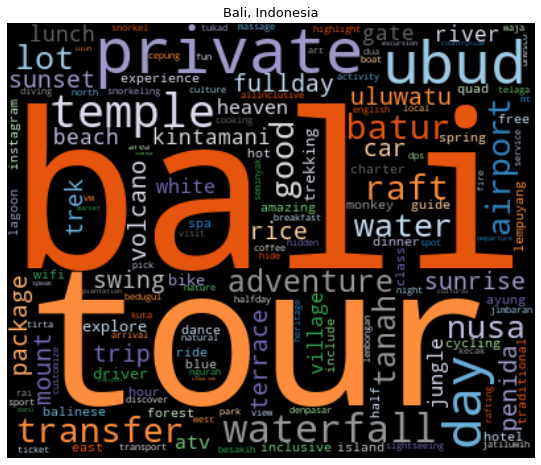

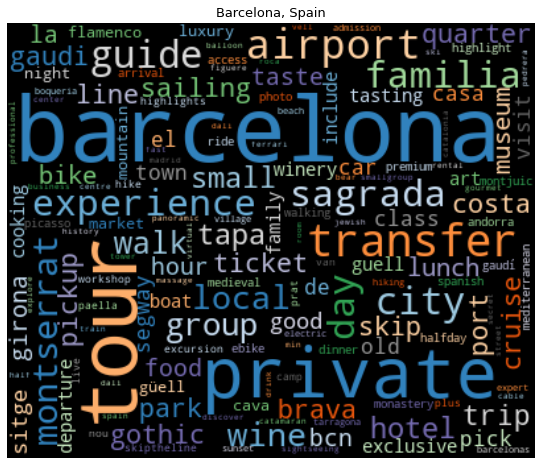

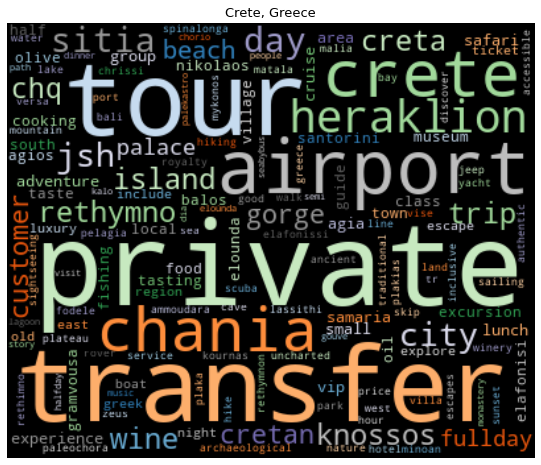

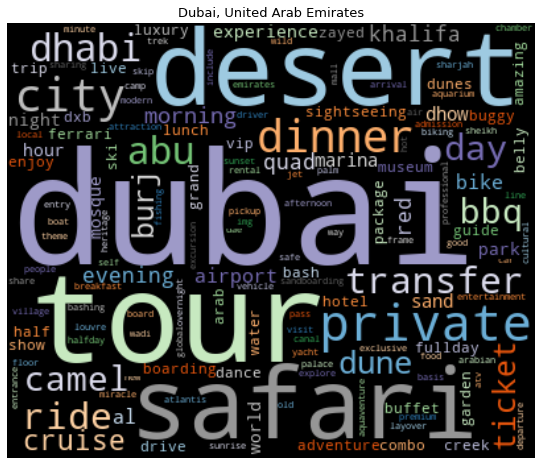

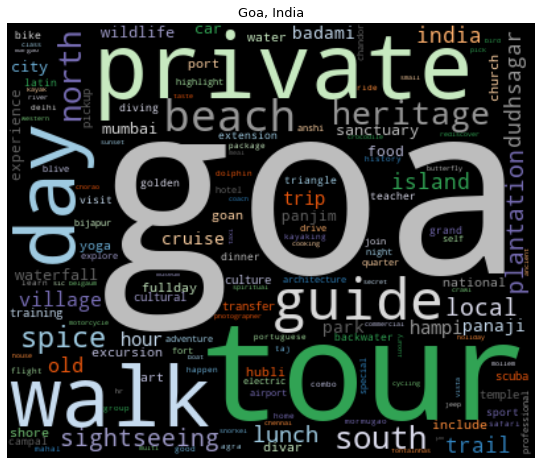

...

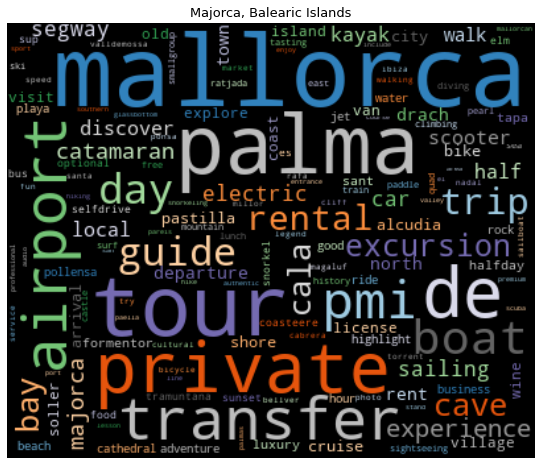

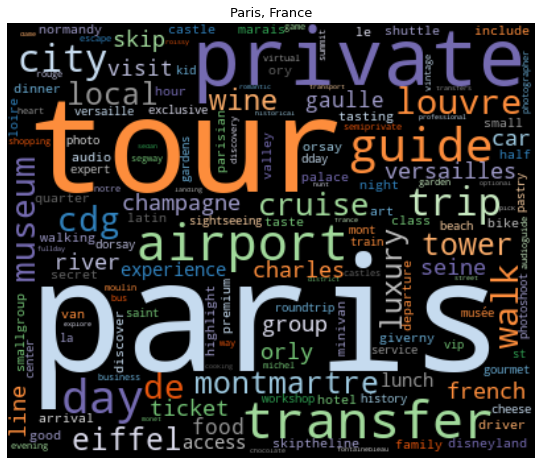

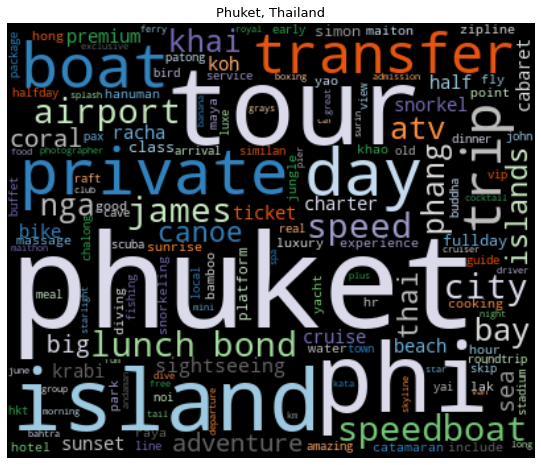

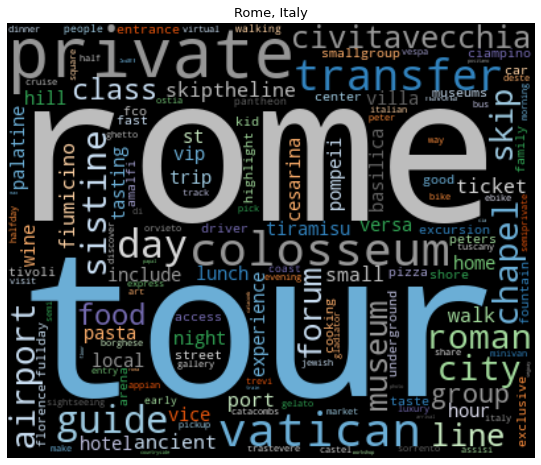

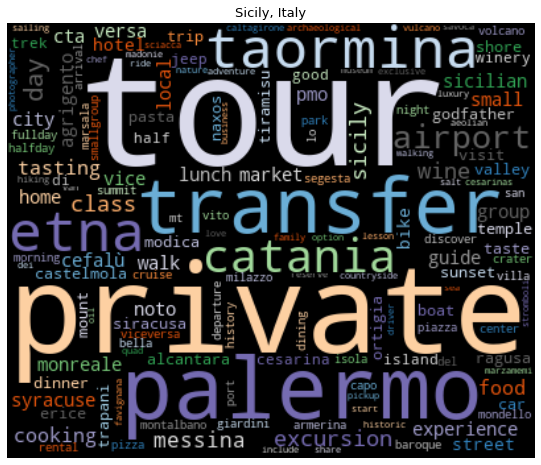

In [30]:
# Transposing document term matrix
df_dtm = df_dtm.transpose()

# Plotting word cloud for each city
for index, city in enumerate(df_dtm.columns):
    generate_wordcloud(df_dtm[city].sort_values(ascending=False), city)

In [31]:
# Look at top words with count vectorizer (in total, not per city)
sum_words = data.sum(axis=0)
words_freq = [(word, sum_words[0, idx]) for word, idx in cv.vocabulary_.items()]
words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
words_freq

[('tour', 13522),
 ('private', 8730),
 ('transfer', 3525),
 ('day', 3518),
 ('airport', 2940),
 ('rome', 2822),
 ('bali', 2359),
 ('dubai', 2331),
 ('city', 2131),
 ('london', 2078),
 ('paris', 1872),
 ('guide', 1604),
 ('istanbul', 1471),
 ('barcelona', 1244),
 ('trip', 1153),
 ('safari', 1056),
 ('dinner', 992),
 ('walk', 990),
 ('desert', 967),
 ('ubud', 926),
 ('cruise', 923),
 ('experience', 884),
 ('ticket', 846),
 ('lunch', 788),
 ('hotel', 781),
 ('museum', 732),
 ('group', 730),
 ('local', 713),
 ('colosseum', 698),
 ('vatican', 696),
 ('good', 678),
 ('phuket', 644),
 ('class', 642),
 ('ride', 640),
 ('fullday', 635),
 ('food', 634),
 ('car', 629),
 ('temple', 620),
 ('island', 596),
 ('wine', 584),
 ('small', 582),
 ('include', 579),
 ('night', 575),
 ('bike', 559),
 ('line', 554),
 ('hour', 540),
 ('luxury', 536),
 ('skip', 528),
 ('adventure', 492),
 ('half', 478),
 ('palermo', 473),
 ('waterfall', 445),
 ('sightseeing', 439),
 ('abu', 434),
 ('dhabi', 431),
 ('tasting', 4

**There seems to be a lot of repetition with words like 'tour', 'private', 'transfer' between cities because all of these cities will have airport transfers, and different tours. However, these words will not help in modeling since they are not unique to the cities.**

#### Word Clouds with TF-IDF Vectorization

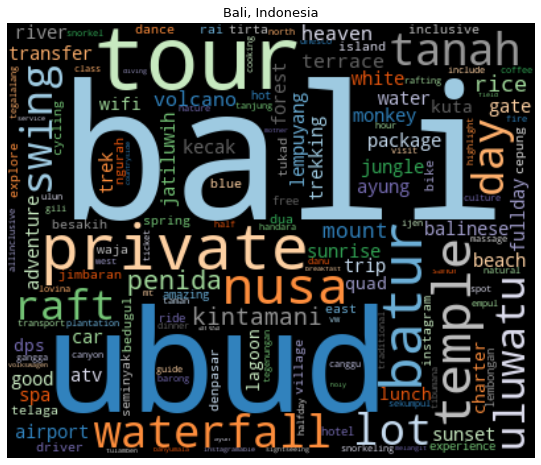

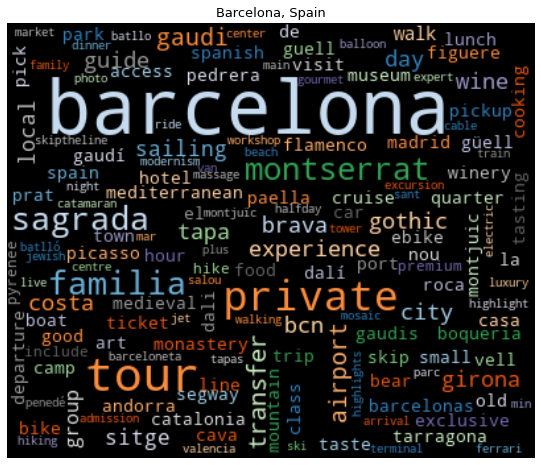

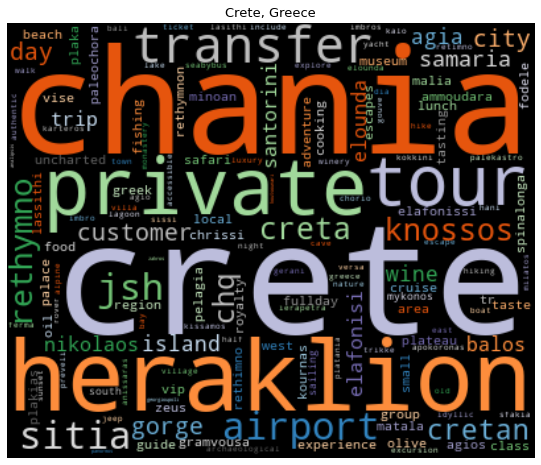

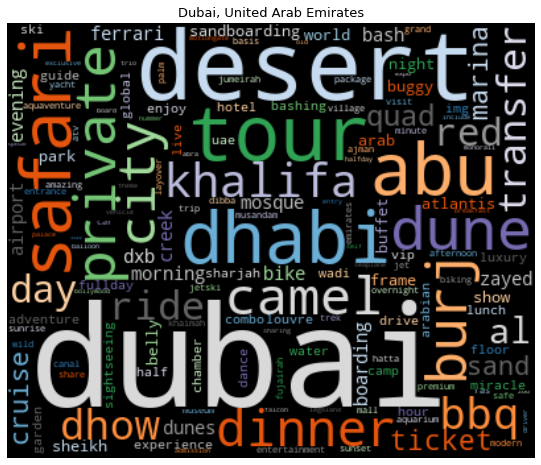

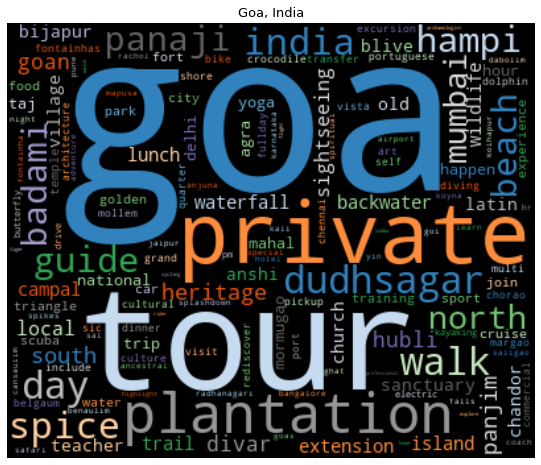

...

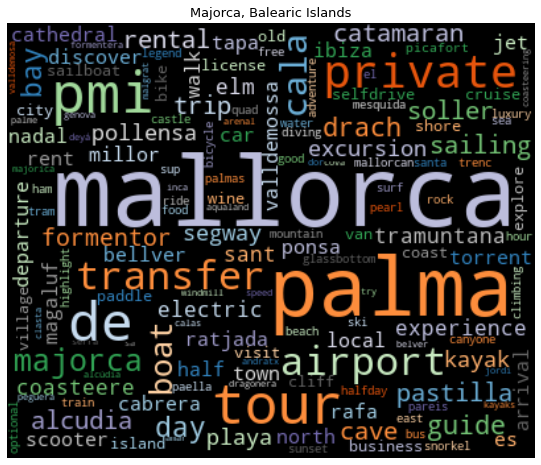

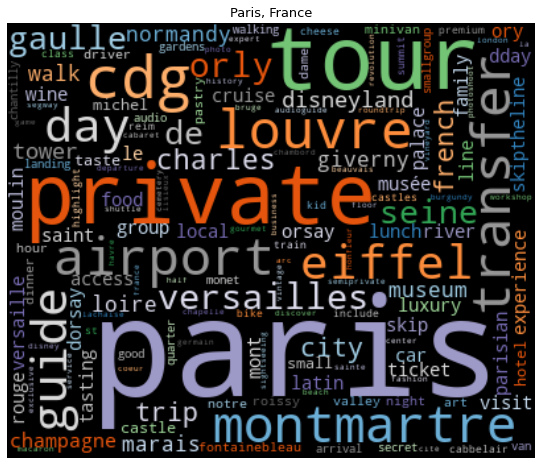

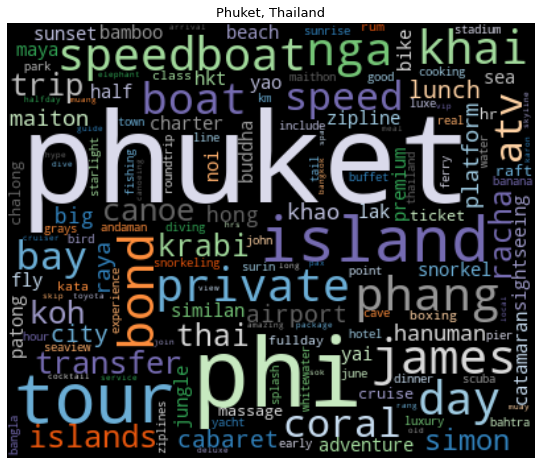

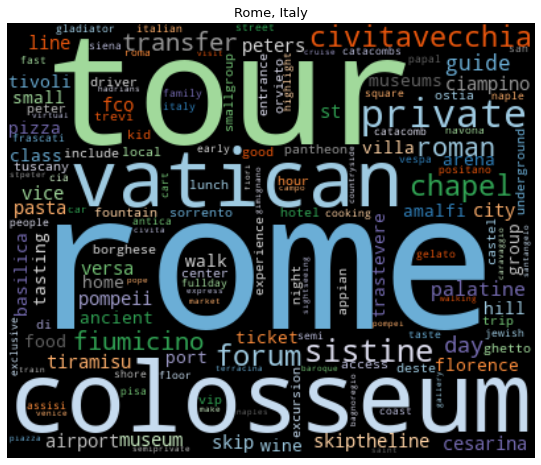

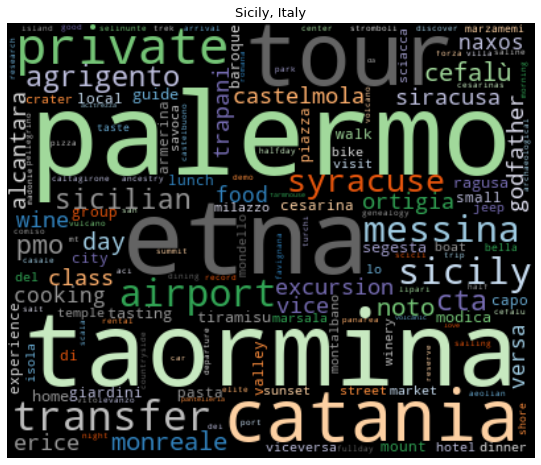

In [32]:
# Transposing document term matrix
df_dtm2 = df_dtm2.transpose()

# Plotting word cloud for each city
for index, city in enumerate(df_dtm2.columns):
    generate_wordcloud(df_dtm2[city].sort_values(ascending=False), city)

In [33]:
# Look at top words with tf-idf vectorization (for total words, not per city)
sum_words = data2.sum(axis=0)
words_freq = [(word, sum_words[0, idx]) for word, idx in tfidf.vocabulary_.items()]
words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
words_freq

[('tour', 3.1397055370950477),
 ('private', 2.0840633636356287),
 ('transfer', 0.9685547196506898),
 ('goa', 0.9226286509898938),
 ('barcelona', 0.9166731088394917),
 ('london', 0.8932185752670296),
 ('paris', 0.8836205705514917),
 ('istanbul', 0.8682353908231614),
 ('airport', 0.857539740811609),
 ('dubai', 0.8422028010450787),
 ('day', 0.8310517134188751),
 ('phuket', 0.8048581266769077),
 ('mallorca', 0.7500827249467662),
 ('bali', 0.7372449047082821),
 ('rome', 0.6645617714771512),
 ('palma', 0.5056361226203647),
 ('crete', 0.47454872097902234),
 ('palermo', 0.469178133177727),
 ('city', 0.46673456115636947),
 ('chania', 0.4478425159022808),
 ('phi', 0.41742641973616024),
 ('guide', 0.404682822706478),
 ('taormina', 0.38629108487377856),
 ('etna', 0.38282140447072066),
 ('heraklion', 0.38004984147670623),
 ('ubud', 0.3768142417586274),
 ('trip', 0.32362608763863426),
 ('catania', 0.323167843289354),
 ('desert', 0.302961532900617),
 ('island', 0.29545707729550164),
 ('colosseum', 0.

**In contrast, there is not as much overlap with these words as in the count vectorization because tf-idf vectorization is finding more words that are unique to the cities. This tells us that tf-idf vectorization is probably a better vectorization technique to use while modeling in order to best predict the cities.**

#### Word Clouds with Bi-Grams

In [34]:
cv2 = CountVectorizer(analyzer='word', stop_words=stopwords_list, ngram_range=(2,2))
data3 = cv2.fit_transform(df_grouped['lemmatized'])
df_dtm3 = pd.DataFrame(data3.toarray(), columns=cv2.get_feature_names())
df_dtm3.index = df_grouped.index
df_dtm3

,aal deep,abandon ghost,abandon hotel,abandon village,abant yedigoller,abba sup,abbate arrival,abbey avebury,abbey banquet,abbey buckingham,...,روما إلى,فورميا العكس,كاستيلوا العكس,مدينة بوجيوا,مدينة تشيتا,مدينة روما,مدينة فورميا,من مدينة,ميرتيتوا العكس,نقل خصوصي
City,,,,,,,,,,,,,,,,,,,,,
"Bali, Indonesia",0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Barcelona, Spain",1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Crete, Greece",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Dubai, United Arab Emirates",0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Goa, India",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Istanbul, Turkey",0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"London, United Kingdom",0,0,0,0,0,1,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
"Majorca, Balearic Islands",0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Paris, France",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


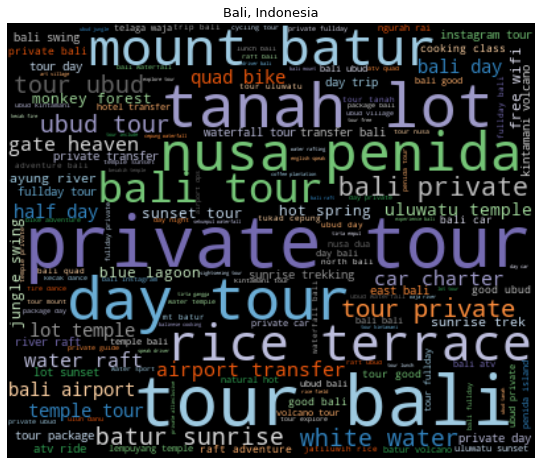

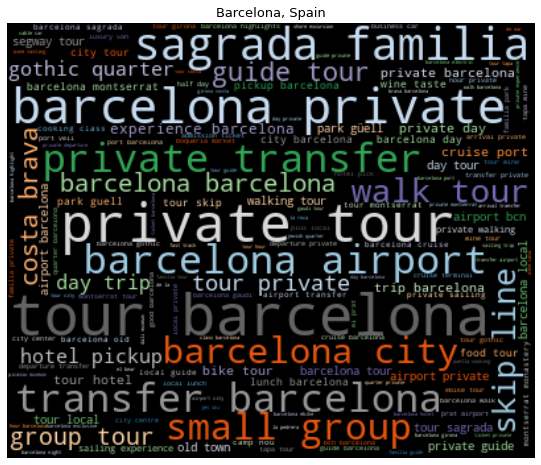

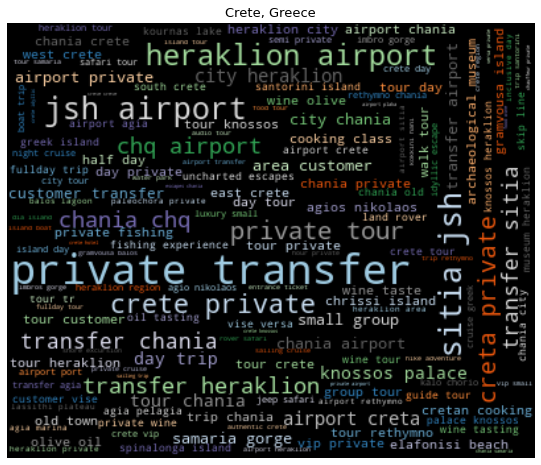

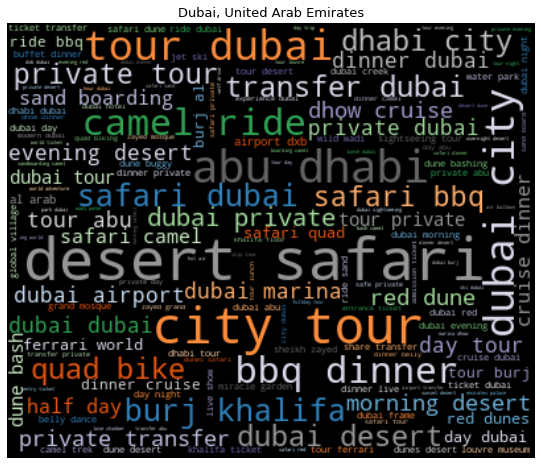

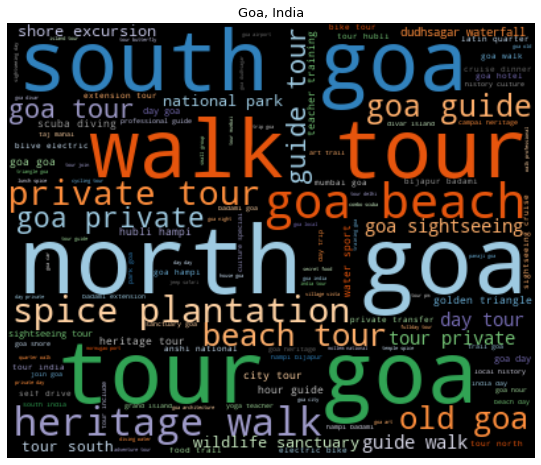

...

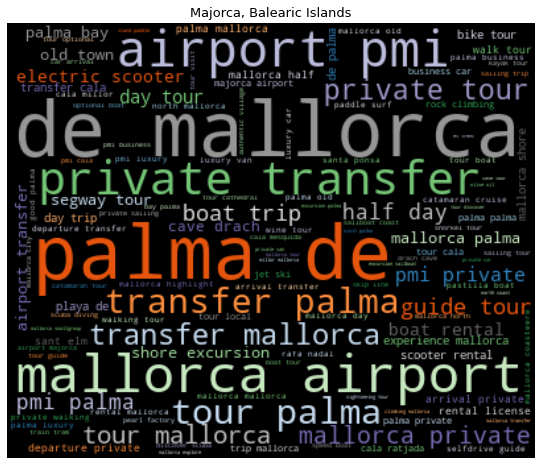

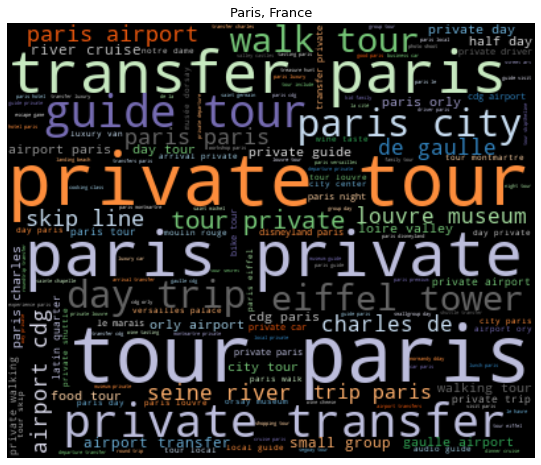

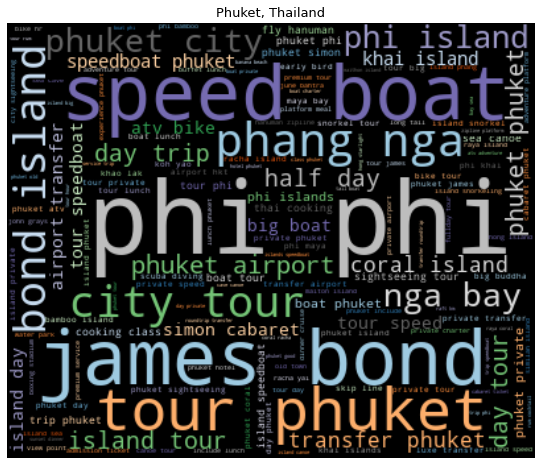

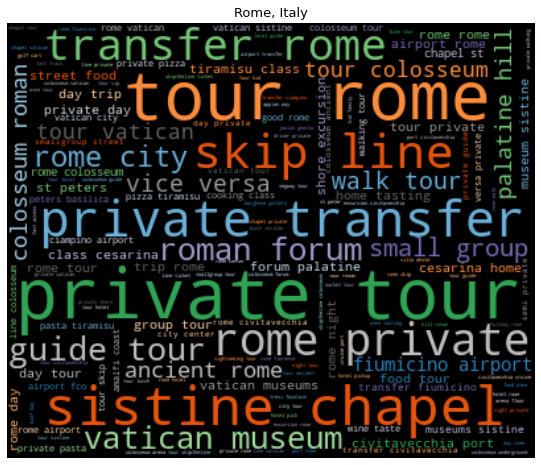

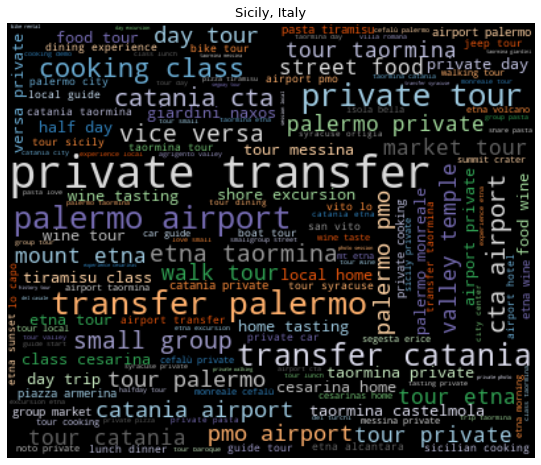

In [35]:
# Transposing document term matrix
df_dtm3 = df_dtm3.transpose()

# Plotting word cloud for each city
for index, city in enumerate(df_dtm3.columns):
    generate_wordcloud(df_dtm3[city].sort_values(ascending=False), city)

In [36]:
# Look at top bi-grams (in total, not per city)
sum_words = data3.sum(axis=0)
words_freq = [(word, sum_words[0, idx]) for word, idx in cv2.vocabulary_.items()]
words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
words_freq

[('private tour', 2228),
 ('private transfer', 1569),
 ('day tour', 824),
 ('city tour', 819),
 ('tour private', 813),
 ('desert safari', 765),
 ('walk tour', 694),
 ('guide tour', 628),
 ('day trip', 589),
 ('small group', 573),
 ('tour rome', 564),
 ('skip line', 513),
 ('airport transfer', 472),
 ('half day', 465),
 ('abu dhabi', 426),
 ('tour london', 423),
 ('tour istanbul', 392),
 ('private day', 386),
 ('tour bali', 350),
 ('sistine chapel', 350),
 ('dubai city', 346),
 ('tour dubai', 344),
 ('cooking class', 303),
 ('tour day', 301),
 ('food tour', 295),
 ('tour paris', 294),
 ('day private', 290),
 ('airport private', 290),
 ('private guide', 285),
 ('bbq dinner', 285),
 ('camel ride', 275),
 ('group tour', 268),
 ('quad bike', 262),
 ('tanah lot', 259),
 ('rome private', 250),
 ('transfer rome', 249),
 ('vice versa', 236),
 ('walking tour', 231),
 ('vatican museum', 230),
 ('roman forum', 228),
 ('shore excursion', 227),
 ('london private', 223),
 ('sightseeing tour', 208),
 

**The bi-grams were able to pick out important terms, such as 'windsor castle' for London, and 'cooking class' for Sicily. However, words like 'tour' are creating some noise in most of these cities.**

## Removing Noise from the Data
Since there are still lots of words in the word clouds like 'private', 'airport' and 'transfer', I want to try to take those attractions for airport transfers out because they are causing noise in the data.

In [37]:
df.head()

,Attraction,City,cleaned,lemmatized
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket,sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london,jack ripper walking tour london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london,ghost bus tour london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hopon hopoff tour and river cru...,big bus london hopon hopoff tour river cruise ...
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom",the blood and tears walk serial killers and lo...,blood tear walk serial killer london horror


In [38]:
# Preview what I want to drop
df.loc[df['Attraction'].str.contains('airport')]

,Attraction,City,cleaned,lemmatized
329,Private transfer from Heathrow airport to Sout...,"London, United Kingdom",private transfer from heathrow airport to sout...,private transfer heathrow airport southampton ...
639,Private transfer from city airport to central ...,"London, United Kingdom",private transfer from city airport to central ...,private transfer city airport central london
640,private transfer from central london to city a...,"London, United Kingdom",private transfer from central london to city a...,private transfer central london city airport
1549,Private airport transfers in London,"London, United Kingdom",private airport transfers in london,private airport transfer london
1830,London airport transfer from Heathrow Airport ...,"London, United Kingdom",london airport transfer from heathrow airport ...,london airport transfer heathrow airport lhr l...
...,...,...,...,...
1407,"Private 4-hour tour of Dubai from hotel, airpo...","Dubai, United Arab Emirates",private tour of dubai from hotel airport or c...,private tour dubai hotel airport cruise loca...
2398,"Dubai airport terminal 1,2 or 3 to Ras Al Khaimah","Dubai, United Arab Emirates",dubai airport terminal or to ras al khaimah,dubai airport terminal ras al khaimah
2407,"Dubai airport terminal 1,2 or 3 to Ajman","Dubai, United Arab Emirates",dubai airport terminal or to ajman,dubai airport terminal ajman
2408,"Dubai airport terminal 1,2 or 3 to Sharjah city","Dubai, United Arab Emirates",dubai airport terminal or to sharjah city,dubai airport terminal sharjah city


In [39]:
# Get rid of the airport transfer 'attractions'
df2 = df.drop(df.loc[df['Attraction'].str.contains('airport')].index)

In [40]:
df2 = df.drop(df2.loc[df2['Attraction'].str.contains('transfer')].index)

In [41]:
# Just in case, add these words to the stopwords list
stopwords_list += ['airport', 'transfer', 'private']

In [42]:
print(df.shape)
print(df2.shape)

(27533, 4)
(25315, 4)


**Create some functions to make the preprocessing steps easier**


In [43]:
def preprocess_df(df, column, preview=True, lemmatize=True):
    """
    Input df with raw text attractions.
    Return df with preprocessed text.
    If preview=True, returns a preview of the new df.
    """
    
    df[column] = df['Attraction'].apply(lambda x: x.lower())
    df[column] = df[column].apply(lambda x: re.sub('[%s]' % re.escape(string.punctuation), '', x))
    df[column] = df[column].apply(lambda x: re.sub('\w*\d\w*','', x))
    
    if lemmatize:
        df[column] = df[column].apply(lambda x: ' '.join(
                                        [token.lemma_ for token in list(nlp(x)) if (token.is_stop==False)]))
    if preview:
        display(df.head(10))
        
    return df

In [44]:
def group_text_per_city(df, column):
    """
    Groups the preprocessed text per city.
    """
    df_to_group = df[['City', column]]
    df_grouped = df_to_group.groupby(by='City').agg(lambda x:' '.join(x))
    return df_grouped

In [47]:
def create_doc_term_matrix(df, column, count_vec=True, ngram_range=(1,1)):
    """
    Creates a document term matrix.
    Defaults to count vectorizer with optional n-gram param.
    If count_vec==False, uses a TF-IDF vectorizer.
    """
    df_grouped = group_text_per_city(df, column)
    
    if count_vec:
        vec = CountVectorizer(analyzer='word', stop_words=stopwords_list, ngram_range=ngram_range)
    else:
        vec = TfidfVectorizer(analyzer='word', stop_words=stopwords_list)
    
    data = vec.fit_transform(df_grouped[column])
    df_dtm = pd.DataFrame(data.toarray(), columns=vec.get_feature_names())
    df_dtm.index = df_grouped.index
    return df_dtm.transpose()

,Attraction,City,cleaned,lemmatized
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom",sea life london aquarium admission ticket,sea life london aquarium admission ticket
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom",the jack the ripper walking tour in london,jack ripper walking tour london
2,Ghost Bus Tour of London,"London, United Kingdom",ghost bus tour of london,ghost bus tour london
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom",big bus london hopon hopoff tour and river cru...,big bus london hopon hopoff tour river cruise ...
5,London Ghost and Infamous Murders Walking Tour,"London, United Kingdom",london ghost and infamous murders walking tour,london ghost infamous murder walk tour
6,"Stonehenge, Windsor Castle, and Bath from London","London, United Kingdom",stonehenge windsor castle and bath from london,stonehenge windsor castle bath london
7,Warner Bros. Studio: The Making of Harry Potte...,"London, United Kingdom",warner bros studio the making of harry potter ...,warner bros studio making harry potter luxury ...
8,"Ghosts, Ghouls & Gallows: London Virtual Tour","London, United Kingdom",ghosts ghouls gallows london virtual tour,ghost ghoul gallow london virtual tour
9,High-Speed Thames River RIB Cruise in London,"London, United Kingdom",highspeed thames river rib cruise in london,highspeed thames river rib cruise london
10,Alcotraz: Prison Cocktail Experience (Shoreditch),"London, United Kingdom",alcotraz prison cocktail experience shoreditch,alcotraz prison cocktail experience shoreditch


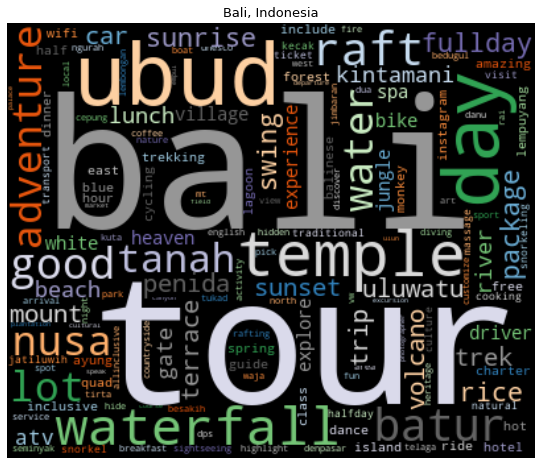

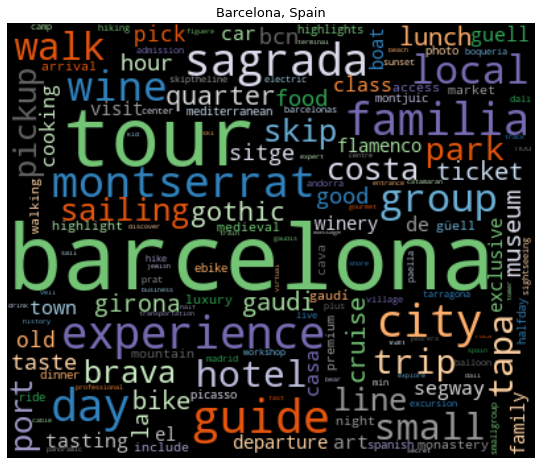

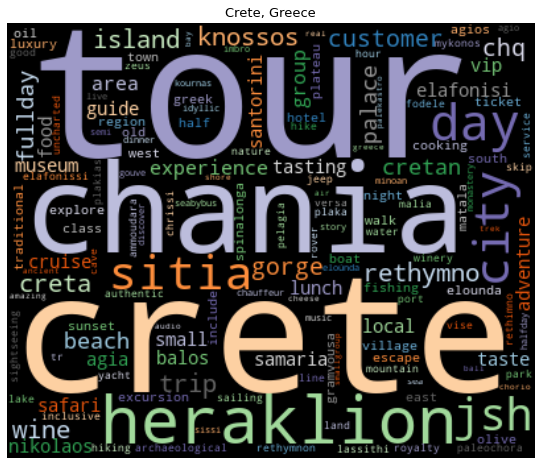

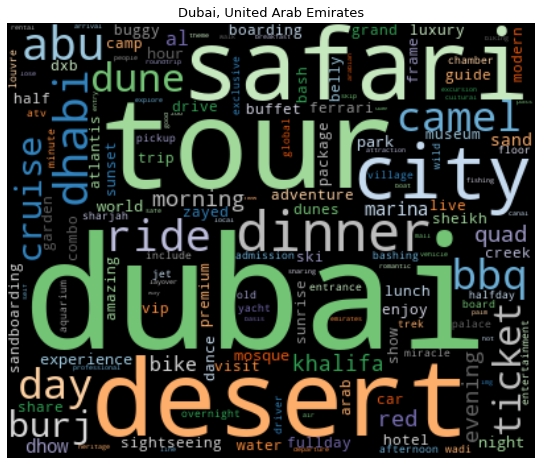

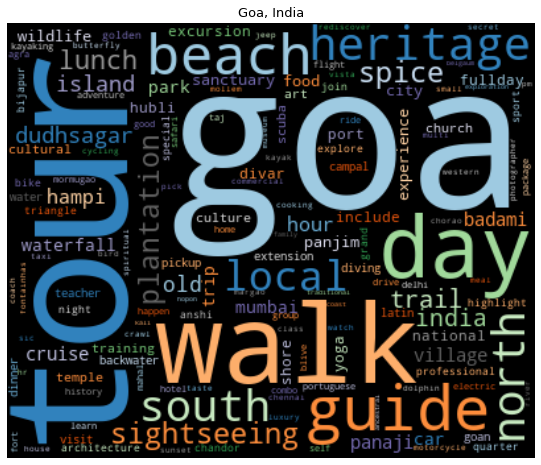

...

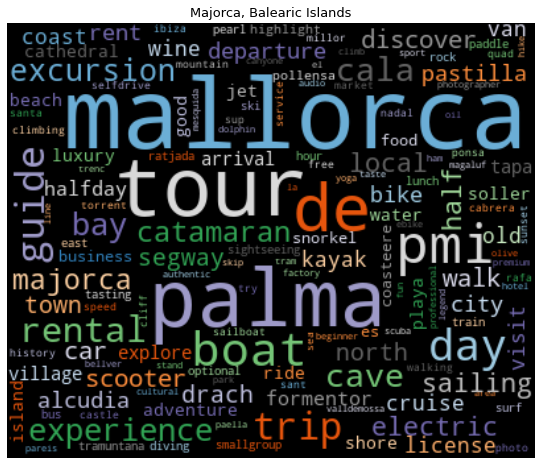

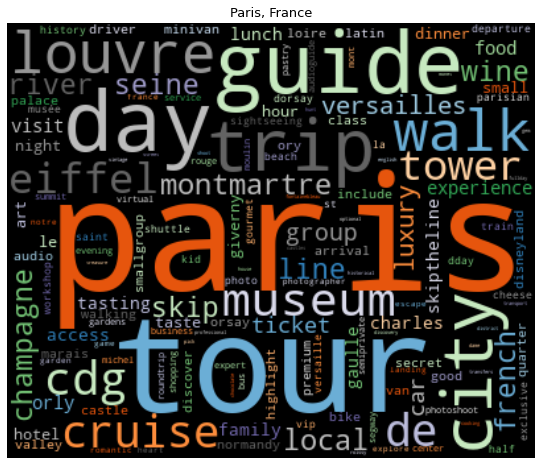

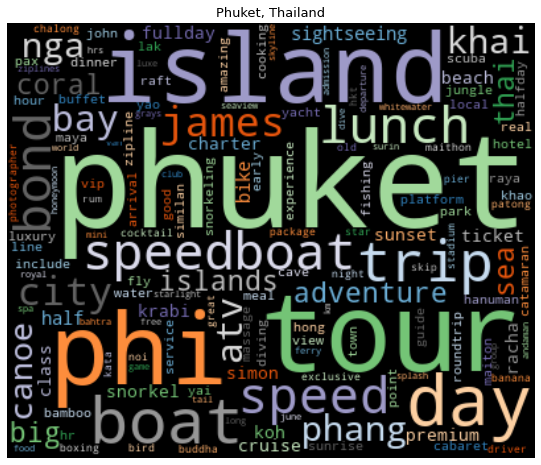

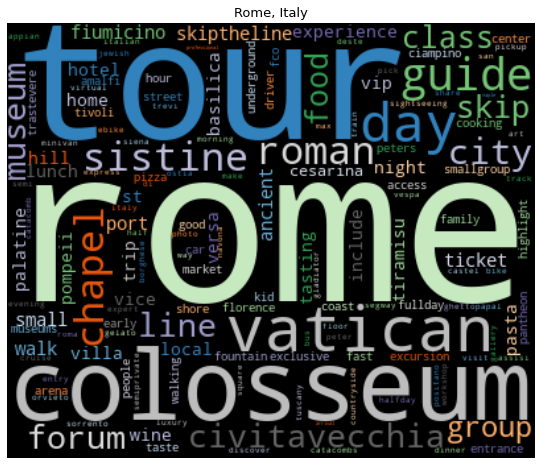

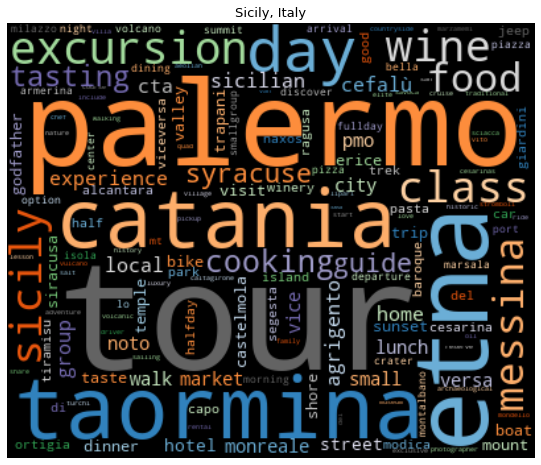

In [48]:
preprocessed_df = preprocess_df(df2, 'lemmatized')
dtm_cv = create_doc_term_matrix(preprocessed_df, 'lemmatized', count_vec=True)

for index, city in enumerate(dtm_cv.columns):
    generate_wordcloud(dtm_cv[city].sort_values(ascending=False), city)

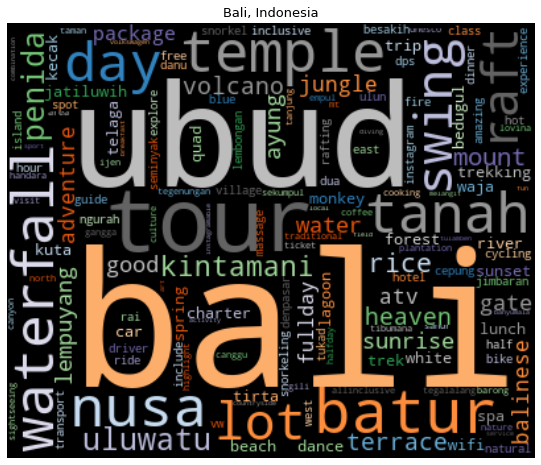

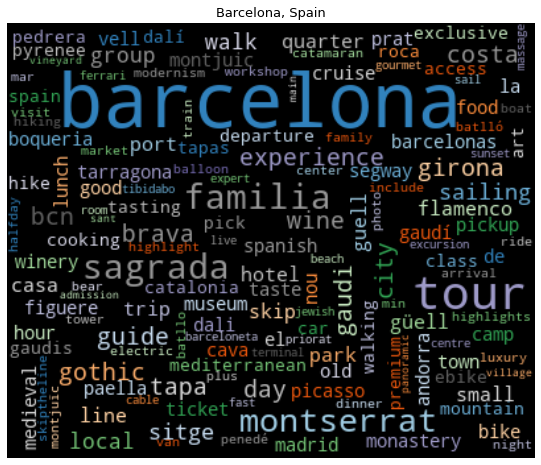

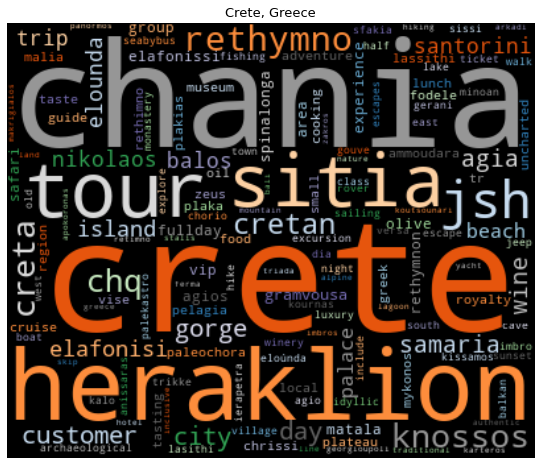

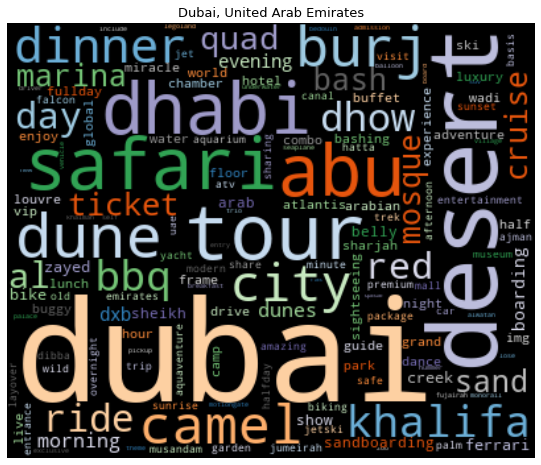

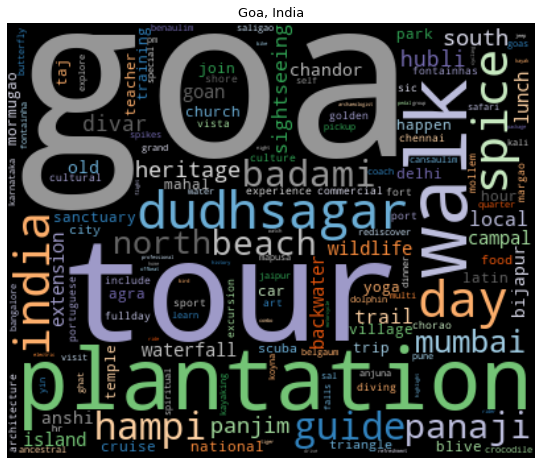

...

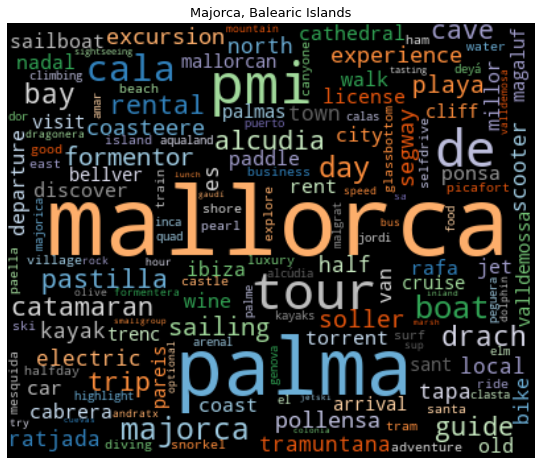

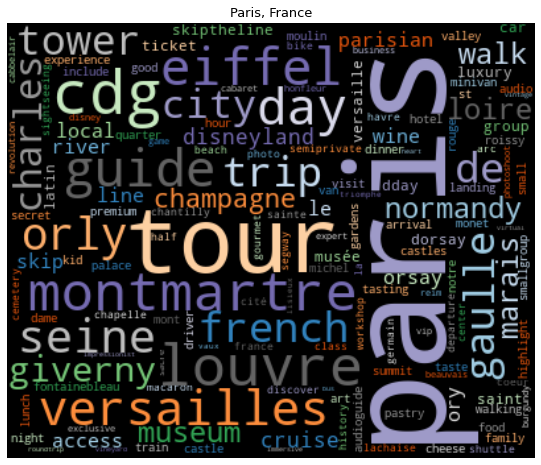

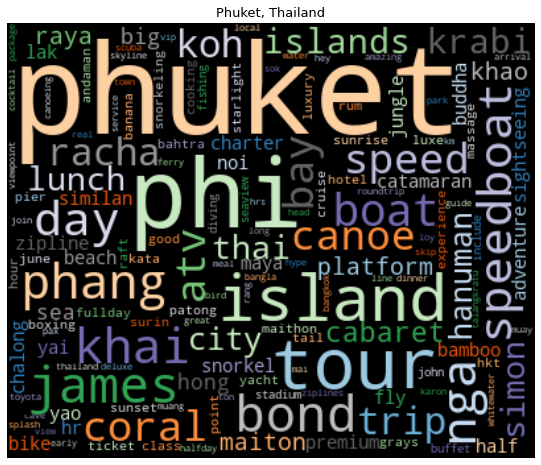

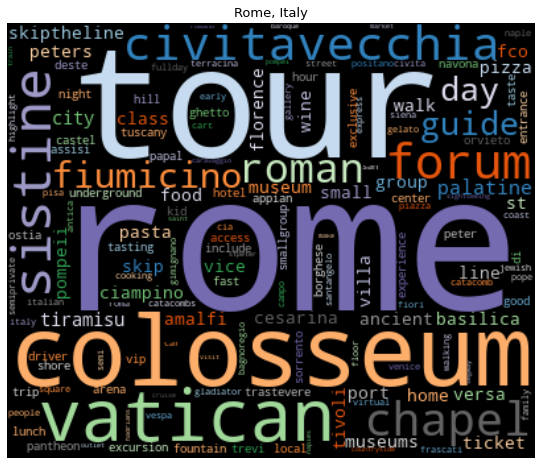

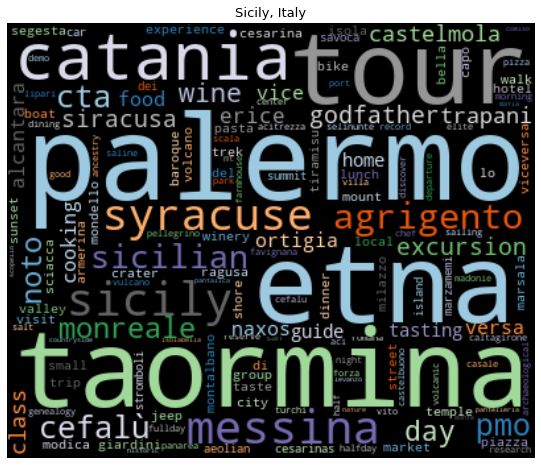

In [49]:
dtm_tfidf = create_doc_term_matrix(df2, 'lemmatized', count_vec=False)

for index, city in enumerate(dtm_tfidf.columns):
    generate_wordcloud(dtm_tfidf[city].sort_values(ascending=False), city)

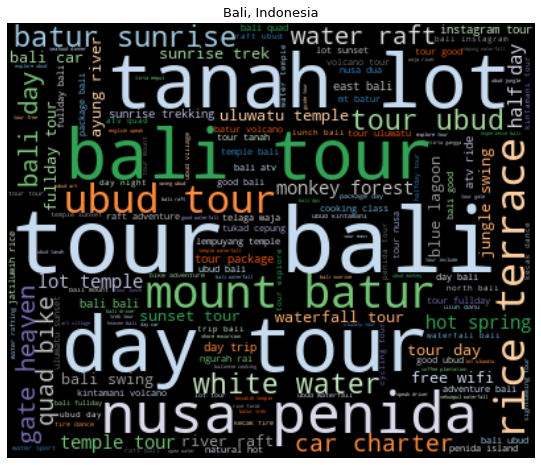

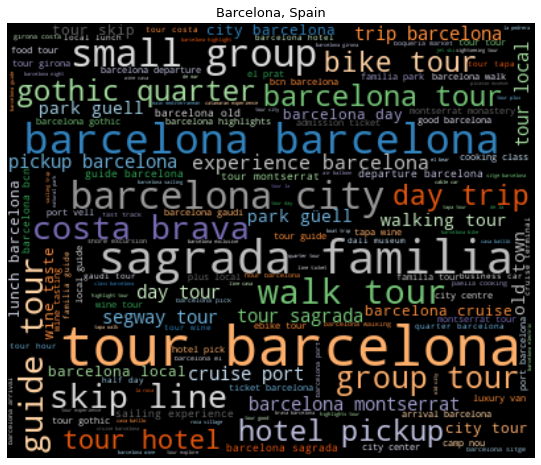

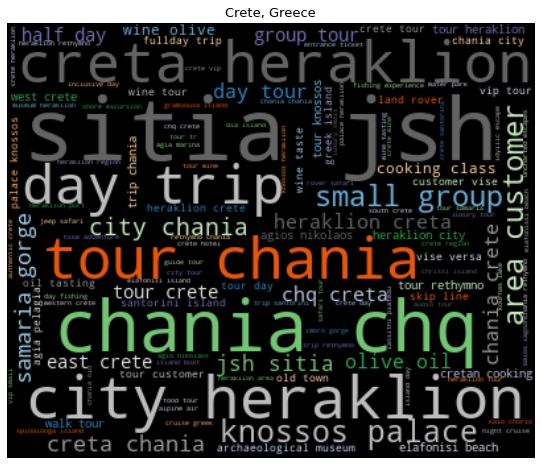

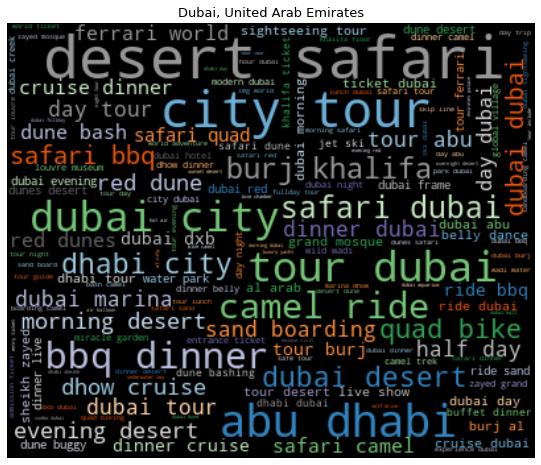

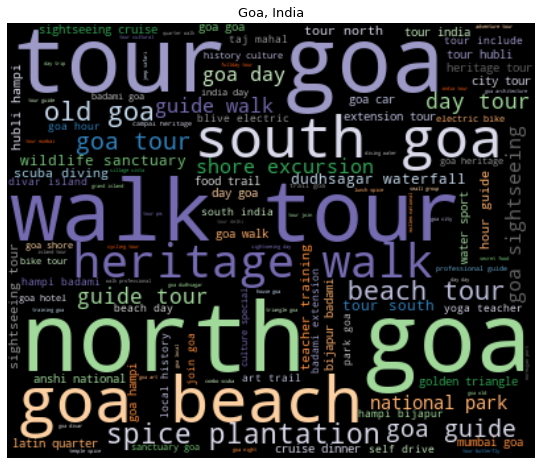

...

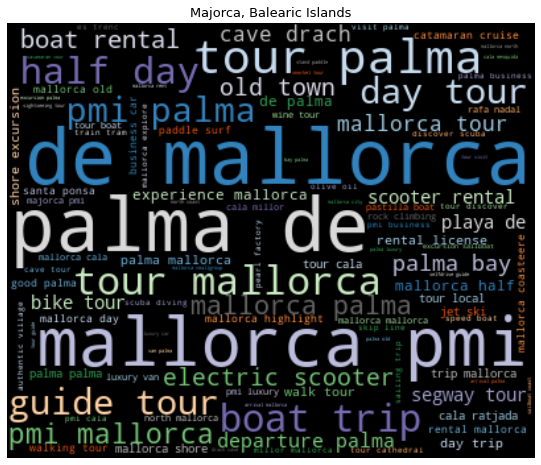

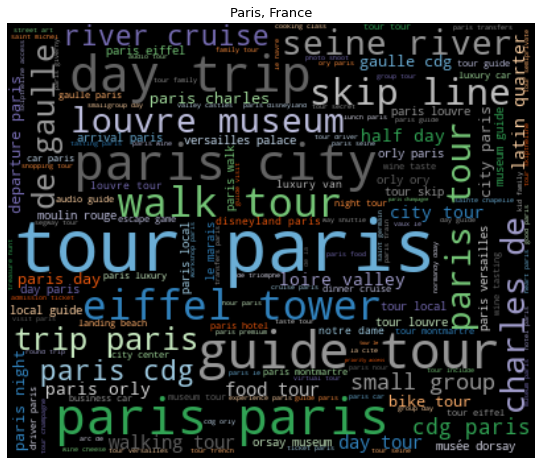

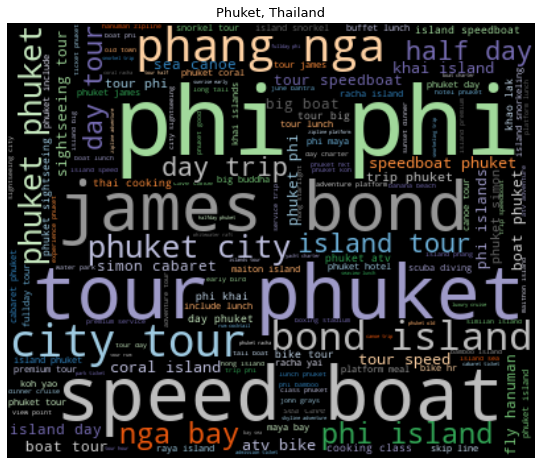

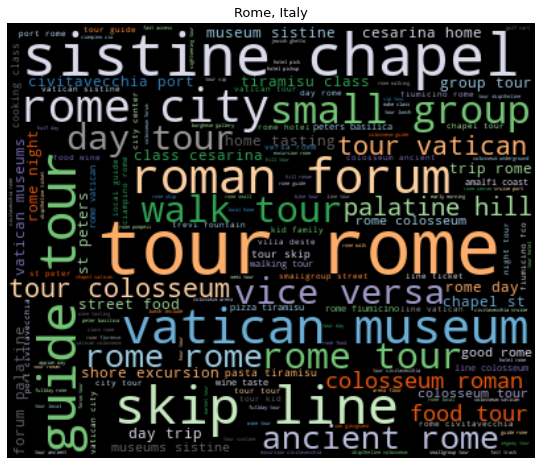

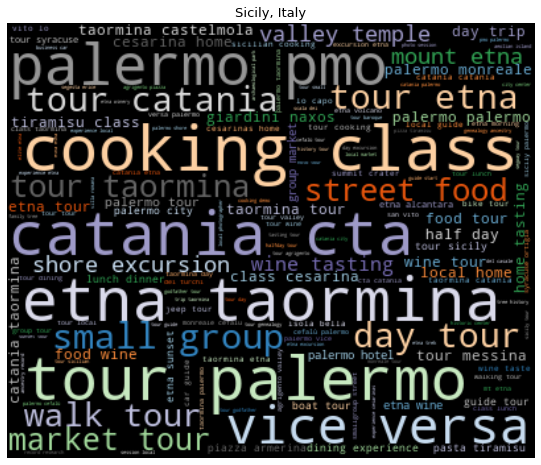

In [50]:
dtm_bigram = create_doc_term_matrix(df2, 'lemmatized',
                                    count_vec=True, ngram_range=(2,2))

for index, city in enumerate(dtm_bigram.columns):
    generate_wordcloud(dtm_bigram[city].sort_values(ascending=False), city)

**Much better! I removed some of the noise terms out of the top words.**

### Make Nicer Word Clouds

In [222]:
def generate_better_wordcloud(data, title, mask=None):
    cloud = WordCloud(scale=3, max_words=150, colormap='tab20c', mask=mask,
                      background_color='white').generate_from_frequencies(data)
    plt.figure(figsize=(10,8))
    plt.imshow(cloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('\n'.join(wrap(title,60)), fontsize=13)
    plt.show()

In [162]:
mask = np.array(Image.open('/Users/tiaplagata/Documents/Flatiron/capstone-project/Images/palm2.jpg'))

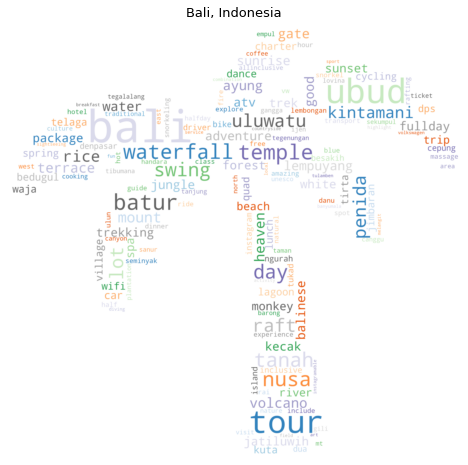

In [223]:
generate_better_wordcloud(dtm_tfidf['Bali, Indonesia'].sort_values(ascending=False),
                          'Bali, Indonesia', mask=mask)

In [164]:
mask_london = np.array(Image.open('/Users/tiaplagata/Documents/Flatiron/capstone-project/Images/ben.jpg'))

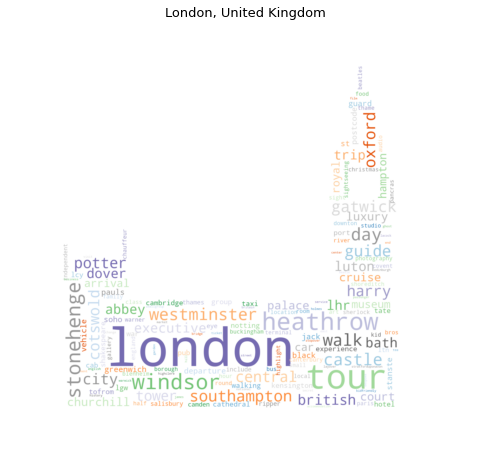

In [224]:
generate_better_wordcloud(dtm_tfidf['London, United Kingdom'].sort_values(ascending=False),
                          'London, United Kingdom', mask=mask_london)

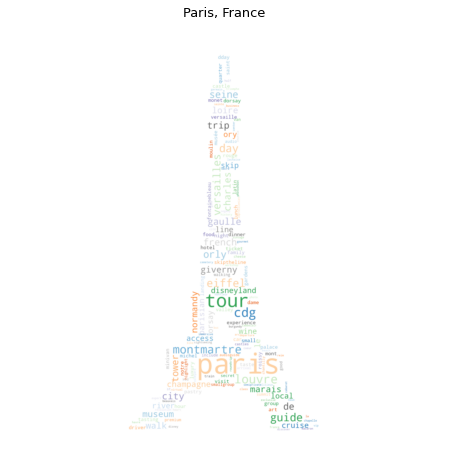

In [225]:
mask_paris = np.array(Image.open('/Users/tiaplagata/Documents/Flatiron/capstone-project/Images/paris.jpg'))
generate_better_wordcloud(dtm_tfidf['Paris, France'].sort_values(ascending=False),
                          'Paris, France', mask=mask_paris)

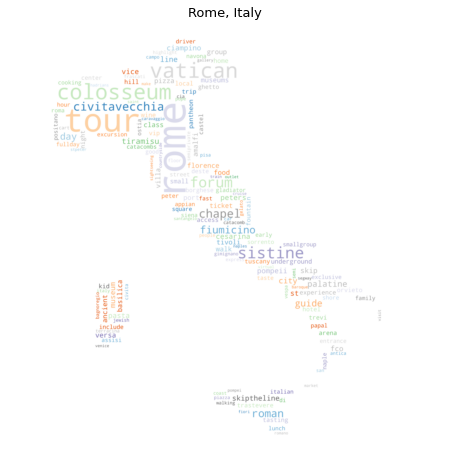

In [167]:
mask_rome = np.array(Image.open('/Users/tiaplagata/Documents/Flatiron/capstone-project/Images/italy.jpg'))
generate_better_wordcloud(dtm_tfidf['Rome, Italy'].sort_values(ascending=False),
                          'Rome, Italy', mask=mask_rome)

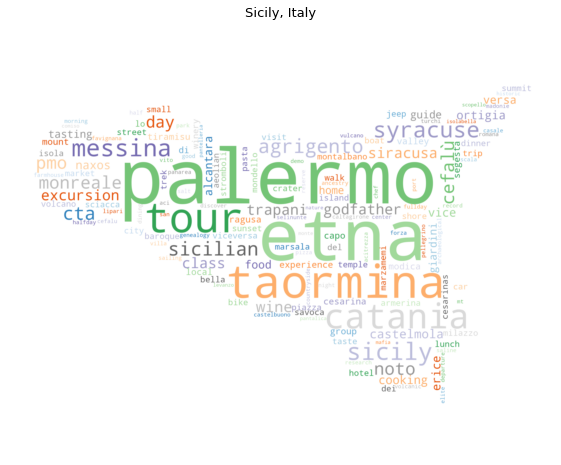

In [168]:
mask_sicily = np.array(Image.open('/Users/tiaplagata/Documents/Flatiron/capstone-project/Images/sicily.jpg'))
generate_better_wordcloud(dtm_tfidf['Sicily, Italy'].sort_values(ascending=False),
                          'Sicily, Italy', mask=mask_sicily)

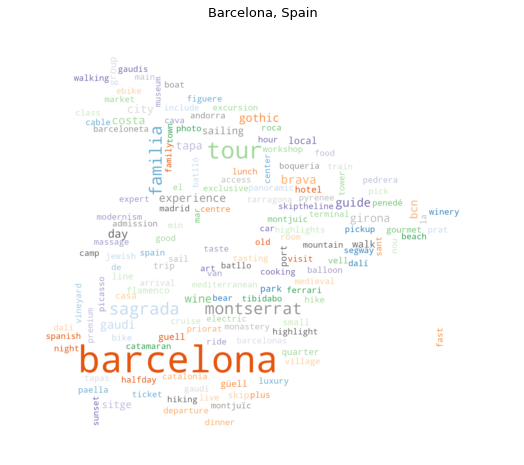

In [169]:
mask_barca = np.array(Image.open('/Users/tiaplagata/Documents/Flatiron/capstone-project/Images/spain_flag.jpg'))
generate_better_wordcloud(dtm_tfidf['Barcelona, Spain'].sort_values(ascending=False),
                          'Barcelona, Spain', mask=mask_barca)

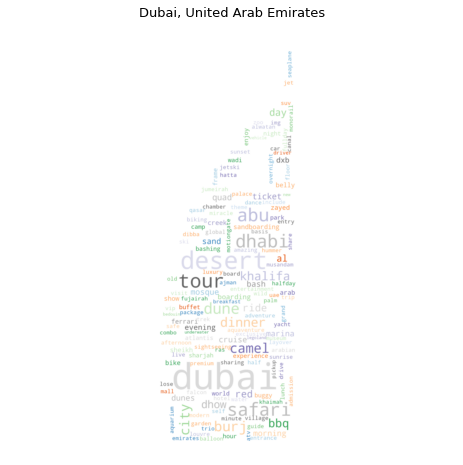

In [170]:
mask_dubai = np.array(Image.open('/Users/tiaplagata/Documents/Flatiron/capstone-project/Images/dubai.jpg'))
generate_better_wordcloud(dtm_tfidf['Dubai, United Arab Emirates'].sort_values(ascending=False),
                          'Dubai, United Arab Emirates', mask=mask_dubai)

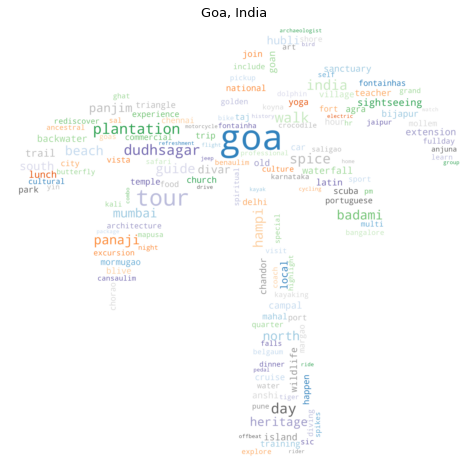

In [171]:
generate_better_wordcloud(dtm_tfidf['Goa, India'].sort_values(ascending=False),
                          'Goa, India', mask=mask)

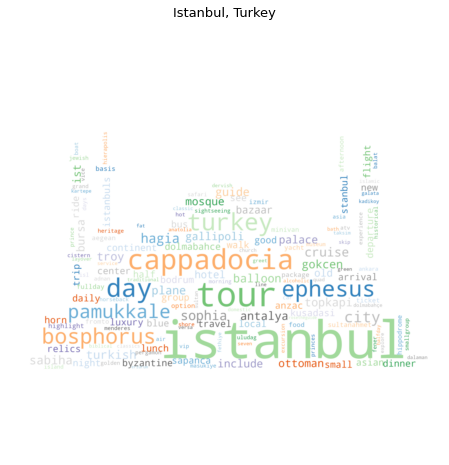

In [172]:
mask_istanbul = np.array(Image.open('/Users/tiaplagata/Documents/Flatiron/capstone-project/Images/hagia_sophia.jpg'))
generate_better_wordcloud(dtm_tfidf['Istanbul, Turkey'].sort_values(ascending=False),
                          'Istanbul, Turkey', mask=mask_istanbul)

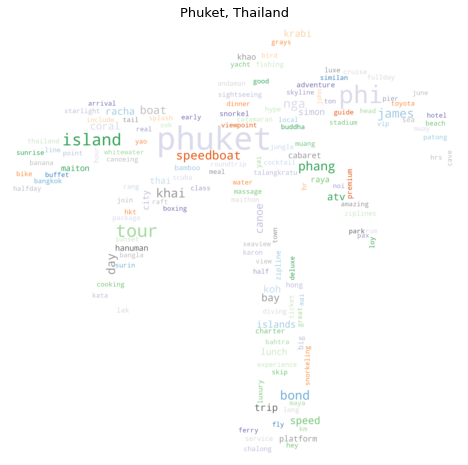

In [173]:
generate_better_wordcloud(dtm_tfidf['Phuket, Thailand'].sort_values(ascending=False),
                          'Phuket, Thailand', mask=mask)

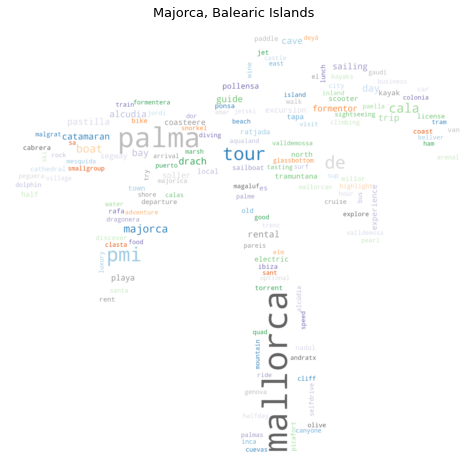

In [174]:
generate_better_wordcloud(dtm_tfidf['Majorca, Balearic Islands'].sort_values(ascending=False),
                          'Majorca, Balearic Islands', mask=mask)

### Most Frequent Words Visualizations
- Find the most frequent words per city and visualize them

In [66]:
# Group the corpora by city and join them
df_to_group = preprocessed_df[['City', 'lemmatized']]
df_grouped = df_to_group.groupby(by='City').agg(lambda x:' '.join(x))
df_grouped

,lemmatized
City,
"Bali, Indonesia",hotel hotelbali private transfer daytime bali ...
"Barcelona, Spain",interactive spanish cooking experience barcelo...
"Crete, Greece",minoans world museum cinema crete wine ol...
"Dubai, United Arab Emirates",premium red dune camel safari bbq al khayma ...
"Goa, India",fontainhas heritage walk sunset cruise paradis...
"Istanbul, Turkey",bosphorus sunset cruise luxury yacht istanbu...
"London, United Kingdom",sea life london aquarium admission ticket jack...
"Majorca, Balearic Islands",cave genova admission palma de mallorca shore ...
"Paris, France",bateaux parisiens seine river gourmet dinner ...


In [67]:
bali_text = df_grouped.loc['Bali, Indonesia', 'lemmatized']
fd = FreqDist(word_tokenize(bali_text))
fd.most_common(20)

[('bali', 2206),
 ('tour', 2187),
 ('private', 1025),
 ('ubud', 869),
 ('day', 669),
 ('temple', 513),
 ('waterfall', 402),
 ('raft', 308),
 ('batur', 292),
 ('transfer', 275),
 ('good', 275),
 ('water', 262),
 ('airport', 253),
 ('adventure', 252),
 ('nusa', 252),
 ('lot', 251),
 ('tanah', 242),
 ('fullday', 231),
 ('package', 226),
 ('swing', 224)]

In [68]:
city_freqs = {}
for city in df_grouped.index:
    city_text = df_grouped.loc[city, 'lemmatized']
    fd = FreqDist(word_tokenize(city_text))
    city_freqs[city] = fd.most_common(20)
city_freqs_df = pd.DataFrame(city_freqs)
city_freqs_df.head()

,"Bali, Indonesia","Barcelona, Spain","Crete, Greece","Dubai, United Arab Emirates","Goa, India","Istanbul, Turkey","London, United Kingdom","Majorca, Balearic Islands","Paris, France","Phuket, Thailand","Rome, Italy","Sicily, Italy"
0,"(bali, 2206)","(barcelona, 1105)","(private, 340)","(dubai, 2144)","(goa, 220)","(istanbul, 1338)","(london, 1862)","(mallorca, 209)","(paris, 1654)","(phuket, 586)","(rome, 2618)","(tour, 759)"
1,"(tour, 2187)","(tour, 861)","(tour, 272)","(tour, 1321)","(tour, 150)","(tour, 1243)","(tour, 1462)","(tour, 144)","(tour, 1152)","(tour, 397)","(tour, 2615)","(private, 554)"
2,"(private, 1025)","(private, 616)","(transfer, 258)","(desert, 900)","(private, 45)","(day, 656)","(private, 1201)","(palma, 133)","(private, 949)","(phi, 310)","(private, 1630)","(palermo, 422)"
3,"(ubud, 869)","(transfer, 166)","(airport, 251)","(safari, 898)","(walk, 41)","(private, 578)","(airport, 439)","(private, 97)","(airport, 293)","(island, 292)","(colosseum, 656)","(transfer, 316)"
4,"(day, 669)","(airport, 152)","(crete, 216)","(private, 708)","(day, 39)","(airport, 299)","(transfer, 404)","(de, 90)","(transfer, 280)","(day, 161)","(vatican, 649)","(etna, 312)"


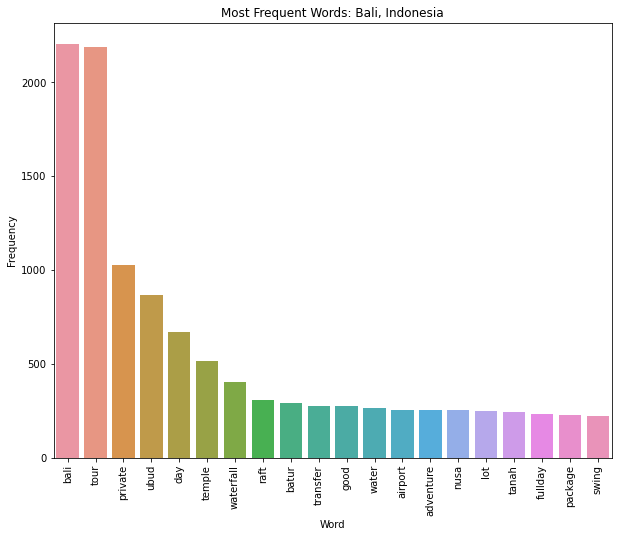

In [69]:
# Make one graph of most frequent words
xaxis = [x[0] for x in city_freqs_df['Bali, Indonesia']]
yaxis = [x[1] for x in city_freqs_df['Bali, Indonesia']]

plt.figure(figsize=(10,8))
sns.barplot(xaxis, yaxis)
plt.title('Most Frequent Words: Bali, Indonesia')
plt.xticks(rotation=90)
plt.xlabel('Word')
plt.ylabel('Frequency')
plt.show()

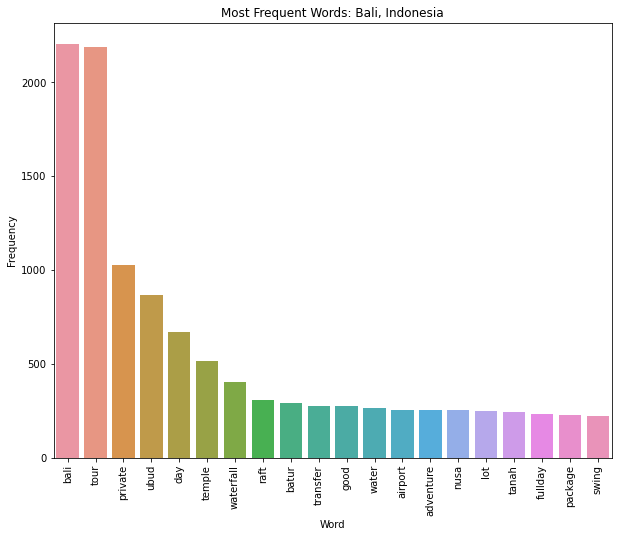

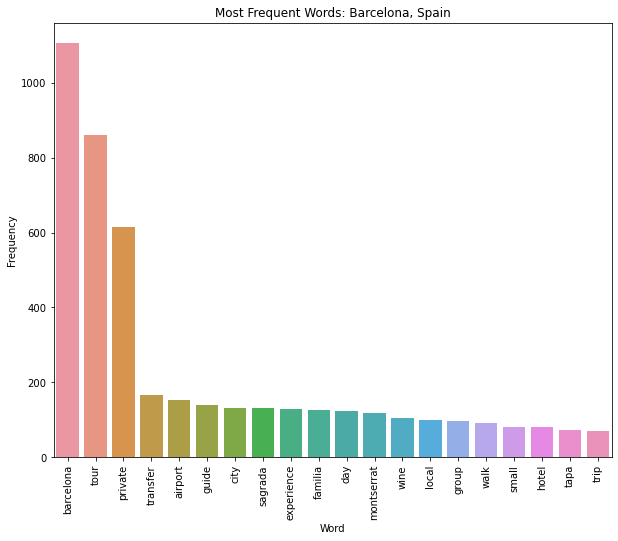

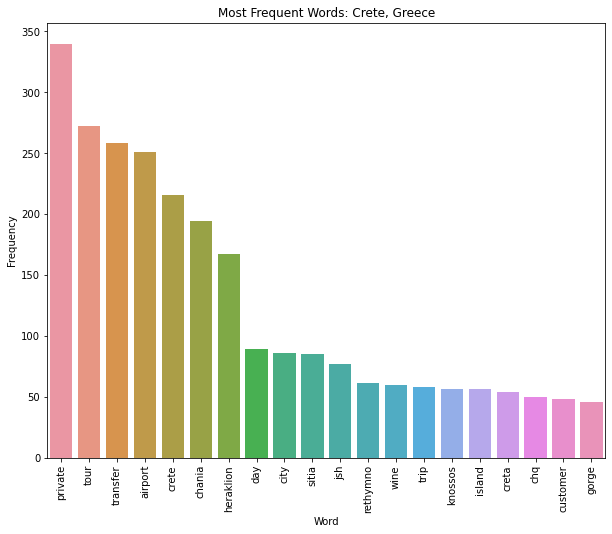

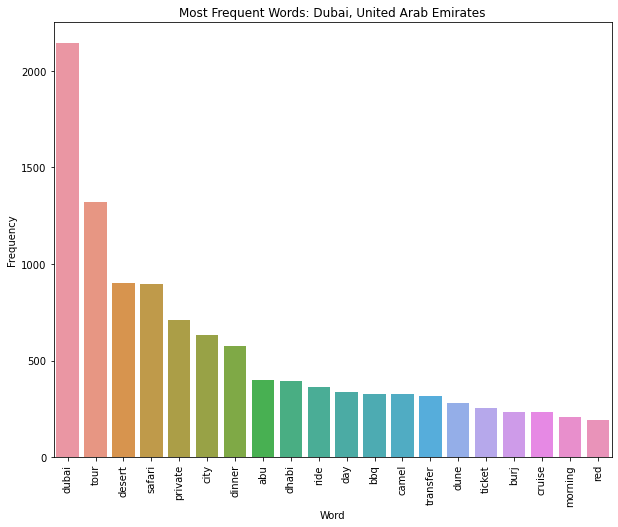

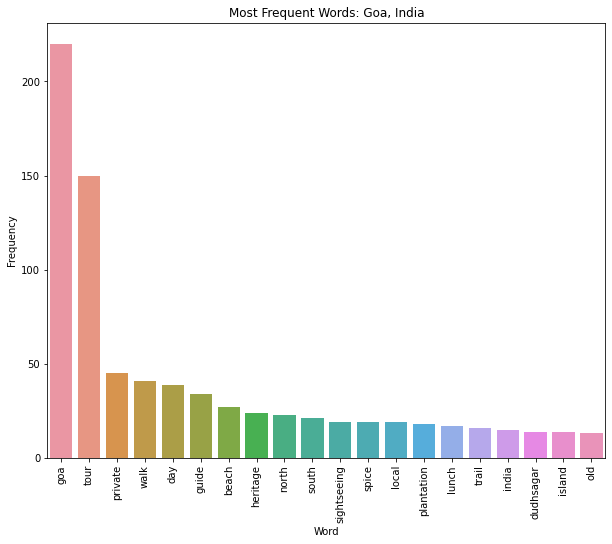

...

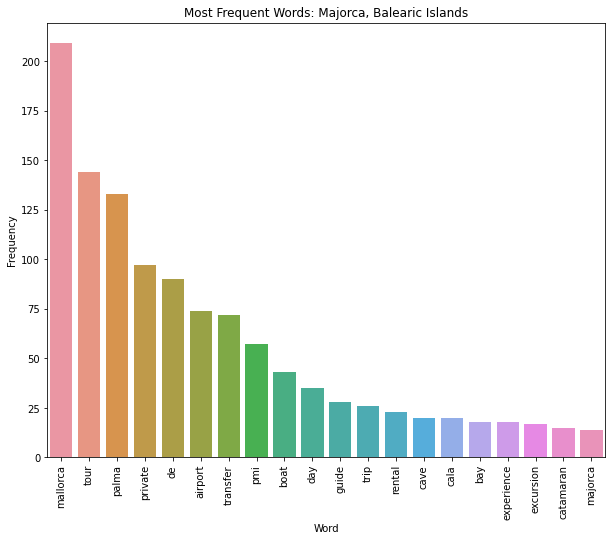

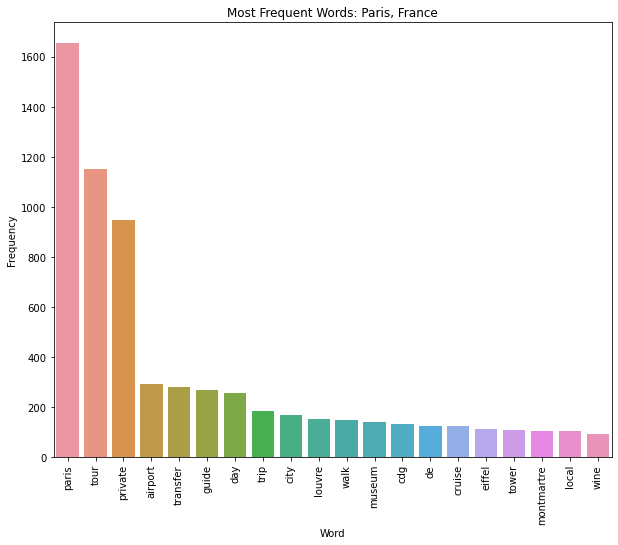

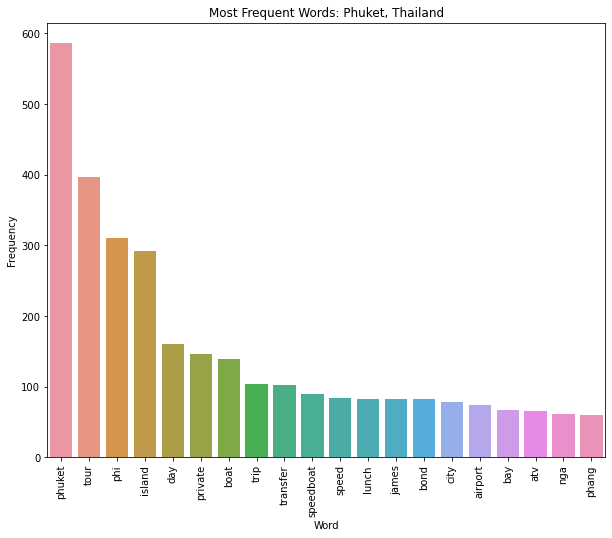

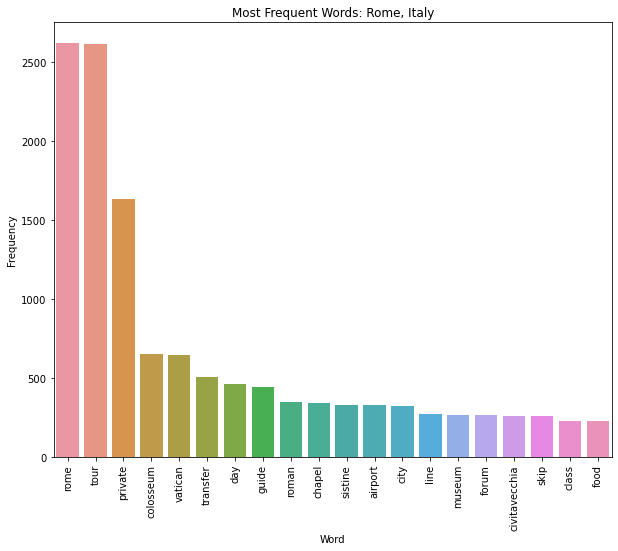

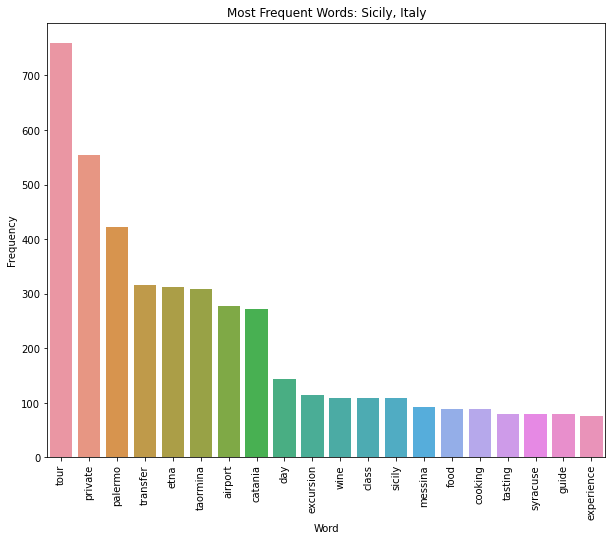

In [70]:
# Make graphs for each city
for city in city_freqs_df.columns:    
    xaxis = [x[0] for x in city_freqs_df[city]]
    yaxis = [x[1] for x in city_freqs_df[city]]

    plt.figure(figsize=(10,8))
    sns.barplot(xaxis, yaxis)
    plt.title(f'Most Frequent Words: {city}')
    plt.xticks(rotation=90)
    plt.xlabel('Word')
    plt.ylabel('Frequency')
    plt.show()

## Modeling

### Baseline Naive Bayes Model 

In [71]:
# Re-import the data to get a fresh start
data = pd.read_csv('/Users/tiaplagata/Documents/Flatiron/capstone-project/Data/cities_df', index_col=0)
data.head()

,Attraction,City
0,SEA LIFE London Aquarium Admission Ticket,"London, United Kingdom"
1,The Jack The Ripper Walking Tour in London,"London, United Kingdom"
2,Ghost Bus Tour of London,"London, United Kingdom"
3,Big Bus London Hop-On Hop-Off Tour and River C...,"London, United Kingdom"
4,The Blood and Tears Walk: Serial Killers and L...,"London, United Kingdom"


In [72]:
# Perform train/test split before cleaning/preprocessing
X = data['Attraction']
y = data['City']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=123)
X_train.shape, X_test.shape

((22703,), (5676,))

In [73]:
# Since this is a series, I will need to make it a DF for my preprocessing function
X_train

2092           The Colosseum and The Ancient City of Rome
814                              Paintball in Canggu/Bali
1920    9Hr Tour London Eye, Westminster Abbey and St ...
348             Dubai 3h Sea escape: Swim! Tan! Sightsee!
3122    Private Bali Half Day Car Charter - Uluwatu Su...
                              ...                        
1428                Barcelona City + La Roca Village Tour
14      Etna, Wine and Alcantara Tour - Small Groups f...
3345                            Fujiearah East Coast Tour
4210    Early Morning Vatican Museums, Sistine Chapel,...
246             Rafa Nadal Museum Mallorca Half Day Tour 
Name: Attraction, Length: 22703, dtype: object

In [74]:
X_train_preprocessed = preprocess_df(pd.DataFrame(X_train, columns=['Attraction']), 'lemmatized')
X_test_preprocessed = preprocess_df(pd.DataFrame(X_test, columns=['Attraction']), 'lemmatized')

,Attraction,lemmatized
2092,The Colosseum and The Ancient City of Rome,colosseum ancient city rome
814,Paintball in Canggu/Bali,paintball canggubali
1920,"9Hr Tour London Eye, Westminster Abbey and St ...",tour london eye westminster abbey st pauls c...
348,Dubai 3h Sea escape: Swim! Tan! Sightsee!,dubai sea escape swim tan sightsee
3122,Private Bali Half Day Car Charter - Uluwatu Su...,private bali half day car charter uluwatu su...
1313,Rooftop Pasta Making Class and Food Market Tou...,rooftop pasta make class food market tour rome
952,"Colosseum, Forum and Baroque Squares",colosseum forum baroque square
972,Gothic Quarter's deepest secrets & Sangria,gothic quarter deep secret sangria
1622,Private Half-Day Montserrat Tour in Afternoon ...,private halfday montserrat tour afternoon pi...
1036,Changing of the Guard Half-Day Private Walking...,change guard halfday private walk london tour


,Attraction,lemmatized
302,Phuket City Tour Fullday,phuket city tour fullday
66,Phuket: Guided Fast Track Phuket Airport,phuket guide fast track phuket airport
208,Guided Montserrat Monastery Day Tour with Hot ...,guide montserrat monastery day tour hot air ba...
3846,Private Pizza & Tiramisu Class at a Cesarina's...,private pizza tiramisu class cesarina home t...
111,Sierra Tramuntana: Mountain Tops and Cosy Vill...,sierra tramuntana mountain top cosy village
1521,Bali Ubud Paon Cooking Class,bali ubud paon cooking class
277,Driver's license free boat rental,driver license free boat rental
230,East bali tour,east bali tour
455,Private Tour: Istanbul Sightseeing Including M...,private tour istanbul sightseeing include muse...
1564,Catania Private Walking Tour,catania private walking tour


In [75]:
stopwords_list = stopwords.words('english')
stopwords_list += list(string.punctuation)
stopwords_list += ['airport', 'transfer', 'private']

In [76]:
# Vectorize the text data to be suitable for modeling
vectorizer = TfidfVectorizer(analyzer='word', stop_words=stopwords_list, decode_error='ignore')
X_train_tfidf = vectorizer.fit_transform(X_train_preprocessed['lemmatized'])
X_test_tfidf = vectorizer.transform(X_test_preprocessed['lemmatized'])

In [77]:
nb = MultinomialNB()
nb.fit(X_train_tfidf.todense(), y_train)

MultinomialNB()

In [78]:
def plot_conf_matrix(y_true, y_pred):
    
    """
    Plots a confusion matrix and displays classification report.
    """
    
    cm = confusion_matrix(y_true, y_pred, normalize='true')
    plt.figure(figsize=(15, 15))
    sns.heatmap(cm, annot=True, cmap='Blues', fmt='0.2g', annot_kws={"size": 14},
                xticklabels=nb.classes_, yticklabels=nb.classes_, square=True)
    plt.xlabel('Predictions')
    plt.ylabel('Actuals')
    plt.show()

In [79]:
def evaluate_model(model, X_train, X_test):
    y_preds_train = model.predict(X_train.todense())
    y_preds_test = model.predict(X_test.todense())

    print('Training Recall:', recall_score(y_train, y_preds_train, average='weighted'))
    print('Testing Recall:', recall_score(y_test, y_preds_test, average='weighted'))
    print('\n---------------\n')
    print('Train Confusion Matrix\n')
    plot_conf_matrix(y_train, y_preds_train)
    print('Test Confusion Matrix\n')
    plot_conf_matrix(y_test, y_preds_test)
    print('\n----------------\n')
    print(classification_report(y_test, y_preds_test))

In [80]:
nb.classes_

array(['Bali, Indonesia', 'Barcelona, Spain', 'Crete, Greece',
       'Dubai, United Arab Emirates', 'Goa, India', 'Istanbul, Turkey',
       'London, United Kingdom', 'Majorca, Balearic Islands',
       'Paris, France', 'Phuket, Thailand', 'Rome, Italy',
       'Sicily, Italy'], dtype='<U27')

Training Recall: 0.9226093467823636
Testing Recall: 0.8921775898520085

---------------

Train Confusion Matrix



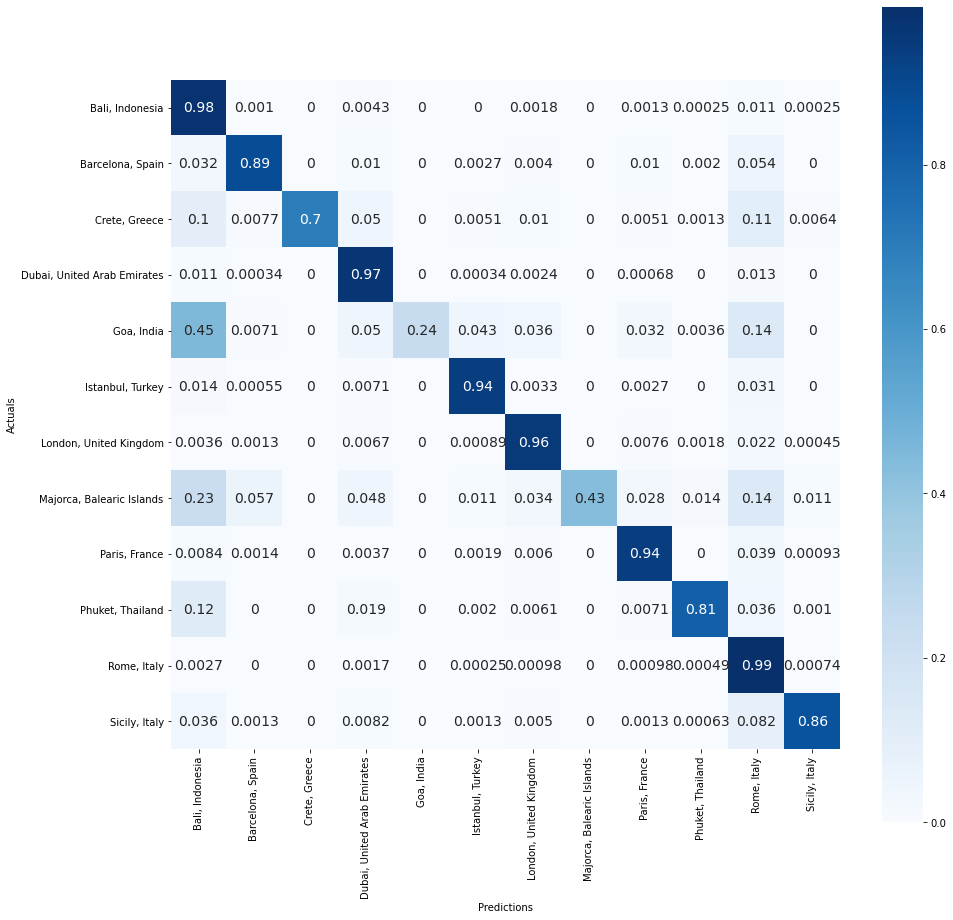

Test Confusion Matrix



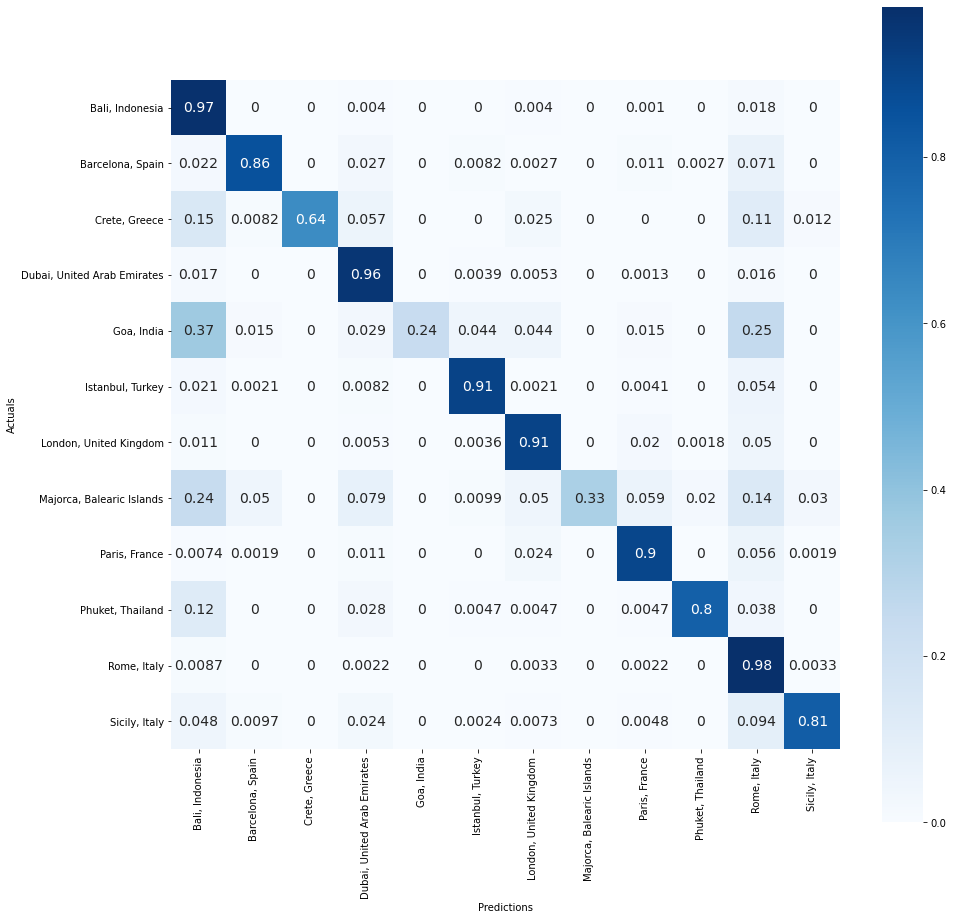


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.84      0.97      0.90      1001
           Barcelona, Spain       0.96      0.86      0.90       368
              Crete, Greece       1.00      0.64      0.78       244
Dubai, United Arab Emirates       0.91      0.96      0.93       760
                 Goa, India       1.00      0.24      0.38        68
           Istanbul, Turkey       0.97      0.91      0.94       485
     London, United Kingdom       0.92      0.91      0.92       563
  Majorca, Balearic Islands       1.00      0.33      0.49       101
              Paris, France       0.94      0.90      0.92       538
           Phuket, Thailand       0.98      0.80      0.88       212
                Rome, Italy       0.79      0.98      0.87       923
              Sicily, Italy       0.97      0.81      0.88       413

                   accuracy                           0.89      5676
             

In [81]:
evaluate_model(nb, X_train_tfidf, X_test_tfidf)

**Surprisingly, this model performs pretty well. However, the 3 classes with the lowest recall scores are Goa, Majorca, and Crete. These are also the 3 classes with the least attractions, meaning that class imbalance is definitely affecting this model. I can fix this issue using class weights in the next iteration.**

### Naive Bayes Iteration 2
- Using class weights to improve class imbalance.

In [82]:
# Compute class weights
class_weights = class_weight.compute_class_weight('balanced',
                                                  np.unique(y_train),
                                                  y_train)
weights_dict = dict(zip(np.unique(y_train), class_weights))
weights_dict

{'Bali, Indonesia': 0.4730974410269234,
 'Barcelona, Spain': 1.272304416050213,
 'Crete, Greece': 2.42864783910997,
 'Dubai, United Arab Emirates': 0.6448250397636901,
 'Goa, India': 6.732799525504152,
 'Istanbul, Turkey': 1.038373582144164,
 'London, United Kingdom': 0.8446056547619047,
 'Majorca, Balearic Islands': 5.359537299338999,
 'Paris, France': 0.8795521462885479,
 'Phuket, Thailand': 1.9129592180653858,
 'Rome, Italy': 0.4640462758564304,
 'Sicily, Italy': 1.1891368112298344}

In [83]:
# Use class weights dictionary to calculate sample weight (needed for MultinomialNB)
sample_weights = class_weight.compute_sample_weight(weights_dict, y_train)

In [84]:
nb = MultinomialNB()
nb.fit(X_train_tfidf.todense(),
       y_train,
       sample_weight=sample_weights)

MultinomialNB()

Training Recall: 0.9581112628287011
Testing Recall: 0.9277660324171952

---------------

Train Confusion Matrix



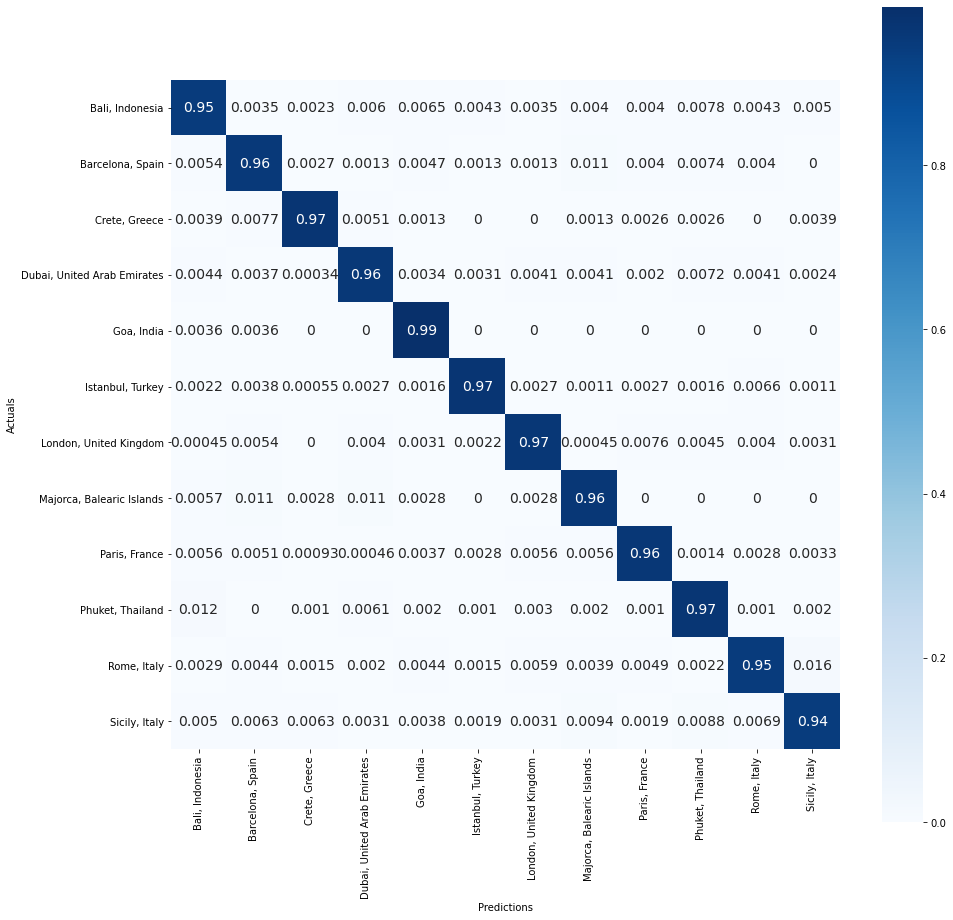

Test Confusion Matrix



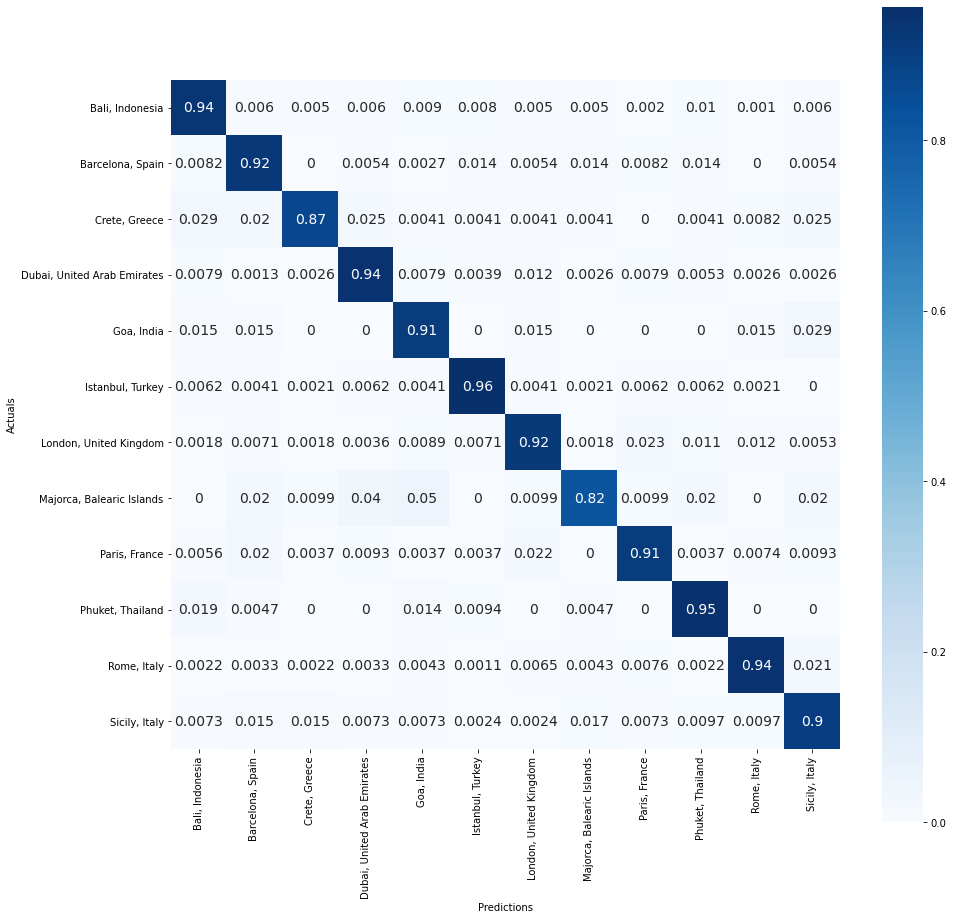


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.97      0.94      0.95      1001
           Barcelona, Spain       0.89      0.92      0.91       368
              Crete, Greece       0.91      0.87      0.89       244
Dubai, United Arab Emirates       0.95      0.94      0.95       760
                 Goa, India       0.60      0.91      0.73        68
           Istanbul, Turkey       0.95      0.96      0.95       485
     London, United Kingdom       0.93      0.92      0.92       563
  Majorca, Balearic Islands       0.75      0.82      0.79       101
              Paris, France       0.93      0.91      0.92       538
           Phuket, Thailand       0.84      0.95      0.89       212
                Rome, Italy       0.98      0.94      0.96       923
              Sicily, Italy       0.89      0.90      0.89       413

                   accuracy                           0.93      5676
             

In [85]:
evaluate_model(nb, X_train_tfidf, X_test_tfidf)

**This model did really well! Although, in many of these cities' attractions text, the name of the city is included. This may become an issue in the future because when we introduce new text to this model, it may not include the city name.**

### Iteration 3: What happens if I take the city names out?

In [86]:
new_stopwords = stopwords_list + ['bali', 'barcelona', 'crete', 'dubai',
                                  'istanbul', 'london', 'majorca', 'phuket',
                                  'paris', 'rome', 'sicily', 'mallorca', 'goa']

In [87]:
vectorizer = TfidfVectorizer(analyzer='word',
                             stop_words=new_stopwords,
                             decode_error='ignore')
X_train_tfidf = vectorizer.fit_transform(X_train_preprocessed['lemmatized'])
X_test_tfidf = vectorizer.transform(X_test_preprocessed['lemmatized'])

In [88]:
nb = MultinomialNB()
nb.fit(X_train_tfidf.todense(),
       y_train,
       sample_weight=sample_weights)

MultinomialNB()

Training Recall: 0.8565387834206933
Testing Recall: 0.8097251585623678

---------------

Train Confusion Matrix



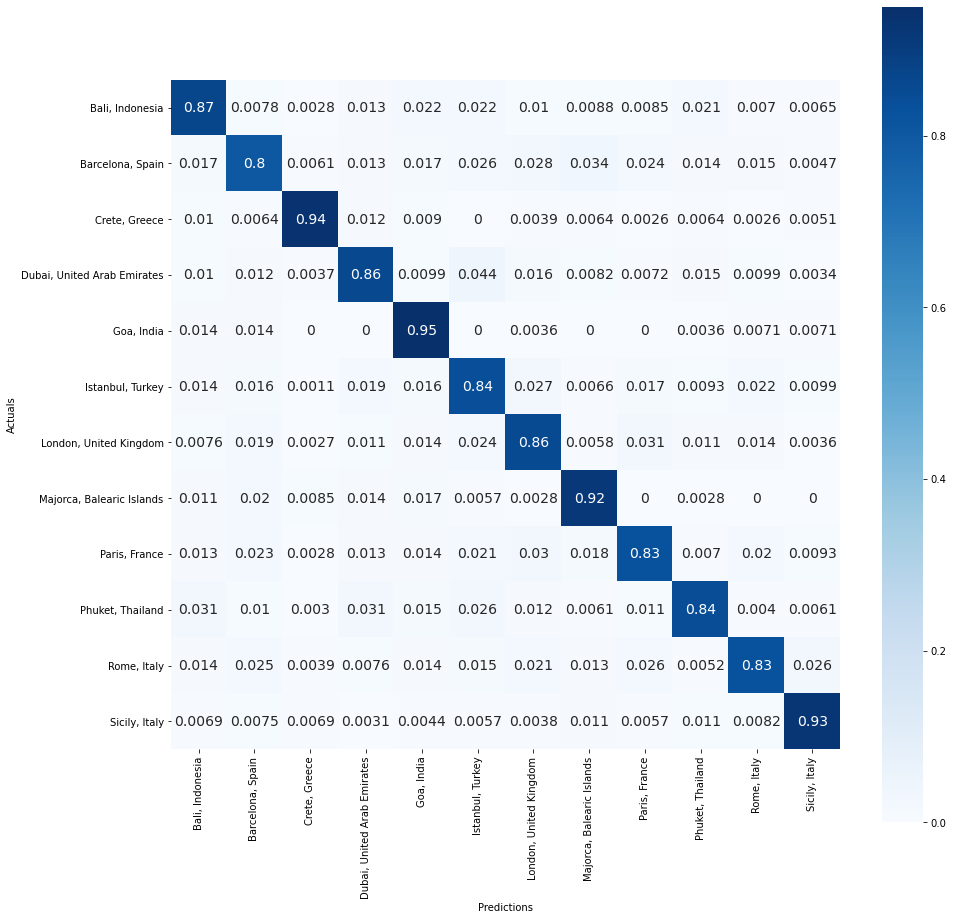

Test Confusion Matrix



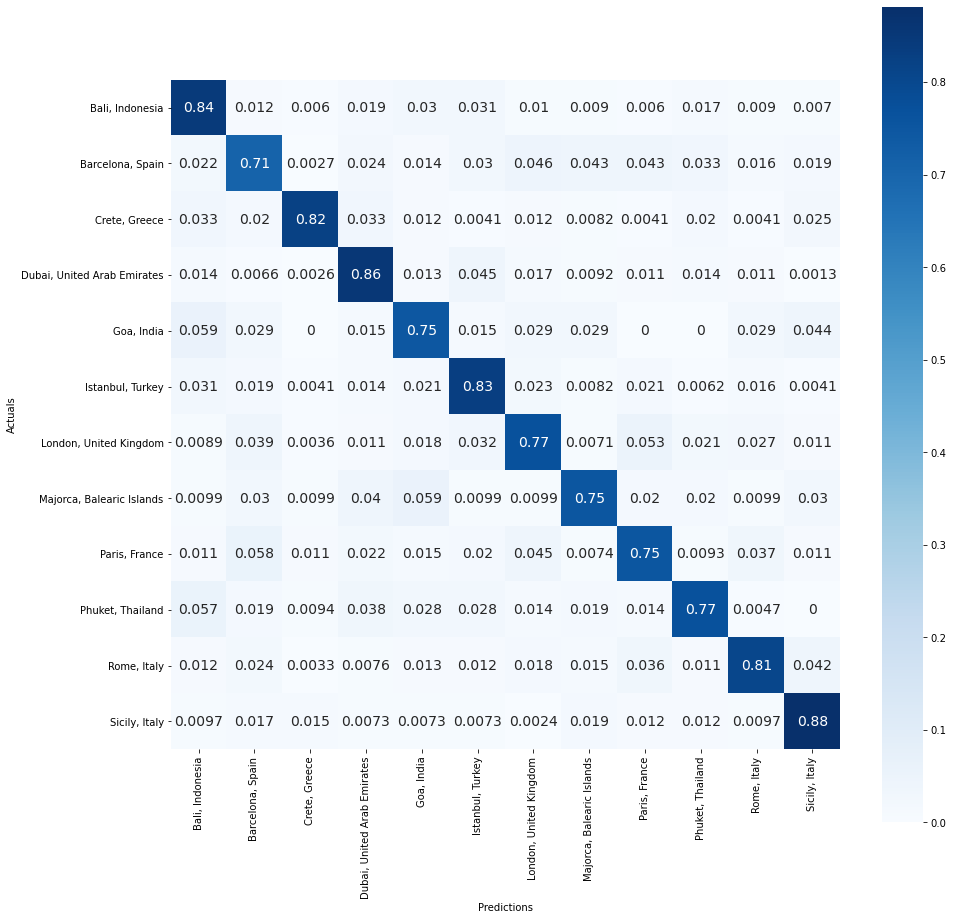


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.91      0.84      0.88      1001
           Barcelona, Spain       0.68      0.71      0.69       368
              Crete, Greece       0.87      0.82      0.84       244
Dubai, United Arab Emirates       0.89      0.86      0.87       760
                 Goa, India       0.33      0.75      0.46        68
           Istanbul, Turkey       0.76      0.83      0.79       485
     London, United Kingdom       0.81      0.77      0.79       563
  Majorca, Balearic Islands       0.51      0.75      0.61       101
              Paris, France       0.78      0.75      0.77       538
           Phuket, Thailand       0.67      0.77      0.71       212
                Rome, Italy       0.91      0.81      0.85       923
              Sicily, Italy       0.82      0.88      0.85       413

                   accuracy                           0.81      5676
             

In [89]:
evaluate_model(nb, X_train_tfidf, X_test_tfidf)

In [90]:
# Pickle the Naive Bayes Model
with open('/Users/tiaplagata/Documents/Flatiron/capstone-project/nb_model',
          'wb') as f:
    pickle.dump(nb, f, pickle.HIGHEST_PROTOCOL)

**Much better, because this is a more realistic recall score for when we introduce new text to the model.**

### Iteration 4: Try using Count Vectorization 

Training Recall: 0.8411663656785446
Testing Recall: 0.7986257928118393

---------------

Train Confusion Matrix



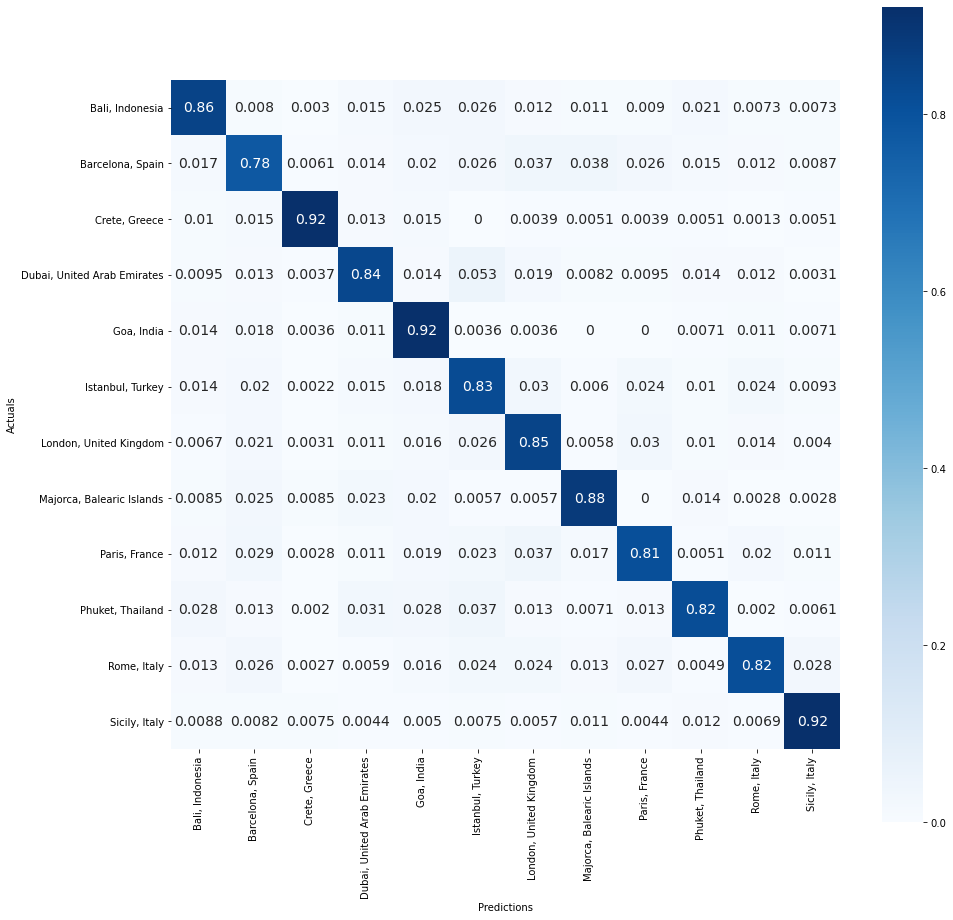

Test Confusion Matrix



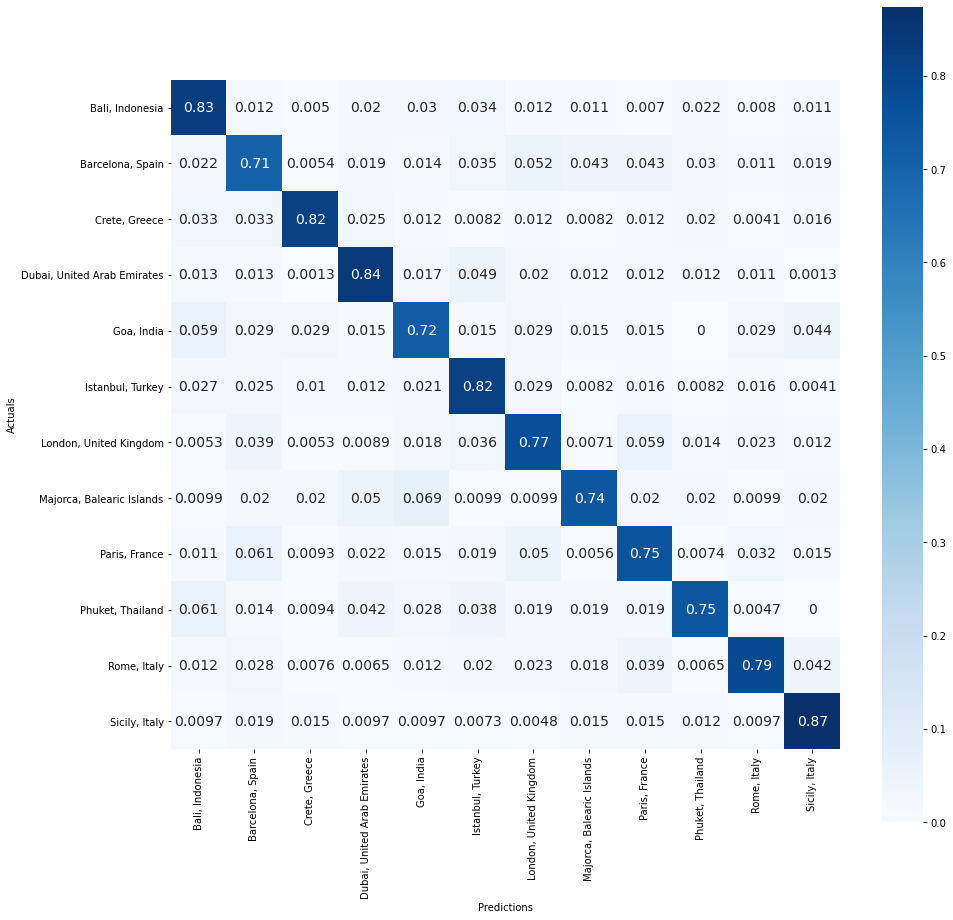


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.91      0.83      0.87      1001
           Barcelona, Spain       0.65      0.71      0.68       368
              Crete, Greece       0.83      0.82      0.82       244
Dubai, United Arab Emirates       0.89      0.84      0.86       760
                 Goa, India       0.31      0.72      0.44        68
           Istanbul, Turkey       0.73      0.82      0.77       485
     London, United Kingdom       0.78      0.77      0.78       563
  Majorca, Balearic Islands       0.49      0.74      0.59       101
              Paris, France       0.76      0.75      0.76       538
           Phuket, Thailand       0.68      0.75      0.71       212
                Rome, Italy       0.92      0.79      0.85       923
              Sicily, Italy       0.81      0.87      0.84       413

                   accuracy                           0.80      5676
             

In [91]:
# Continuing each new iteration without city names 
cv = CountVectorizer(analyzer='word',
                     stop_words=new_stopwords,
                     decode_error='ignore')
X_train_cv = cv.fit_transform(X_train_preprocessed['lemmatized'])
X_test_cv = cv.transform(X_test_preprocessed['lemmatized'])
nb_cv = MultinomialNB()
nb_cv.fit(X_train_cv.todense(),
          y_train,
          sample_weight=sample_weights)
evaluate_model(nb_cv, X_train_cv, X_test_cv)

**With count vectorization, the recall score is very similar, but still a tiny bit lower than with TF-IDF vectorization, therefore I will keep the TF-IDF vectorization strategy.**

### Iteration 5: Try using Bi-Grams

Training Recall: 0.9017310487600758
Testing Recall: 0.7330866807610994

---------------

Train Confusion Matrix



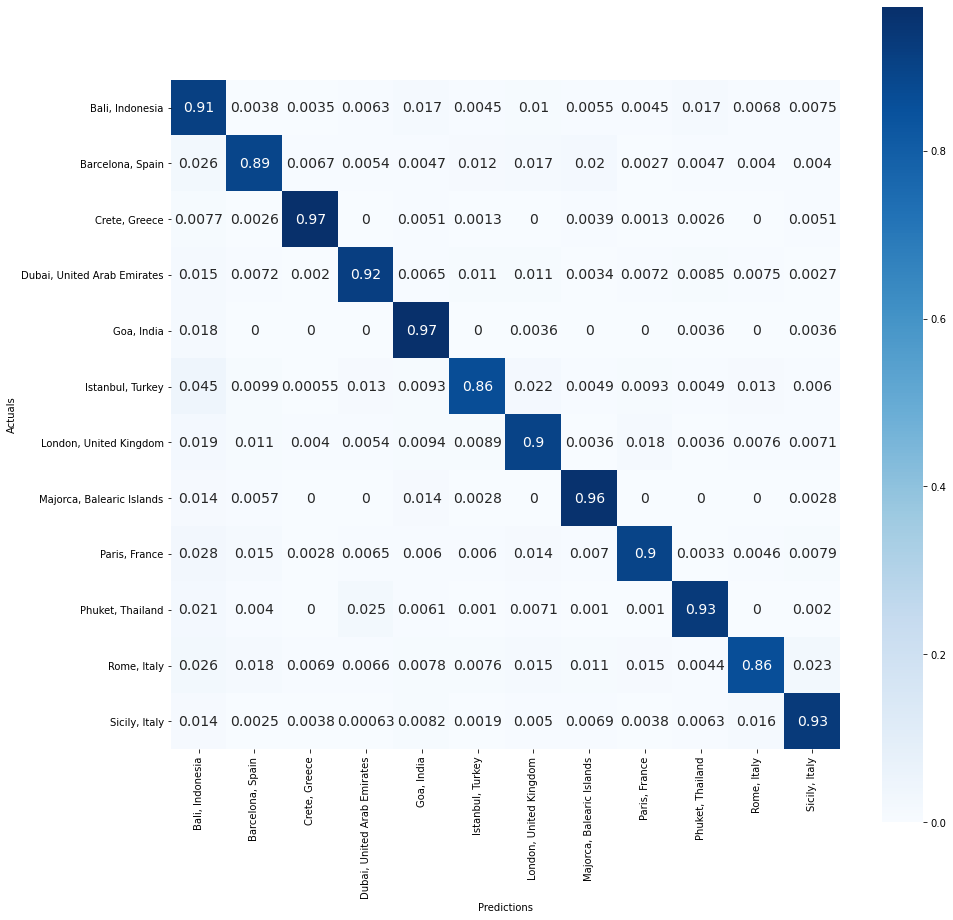

Test Confusion Matrix



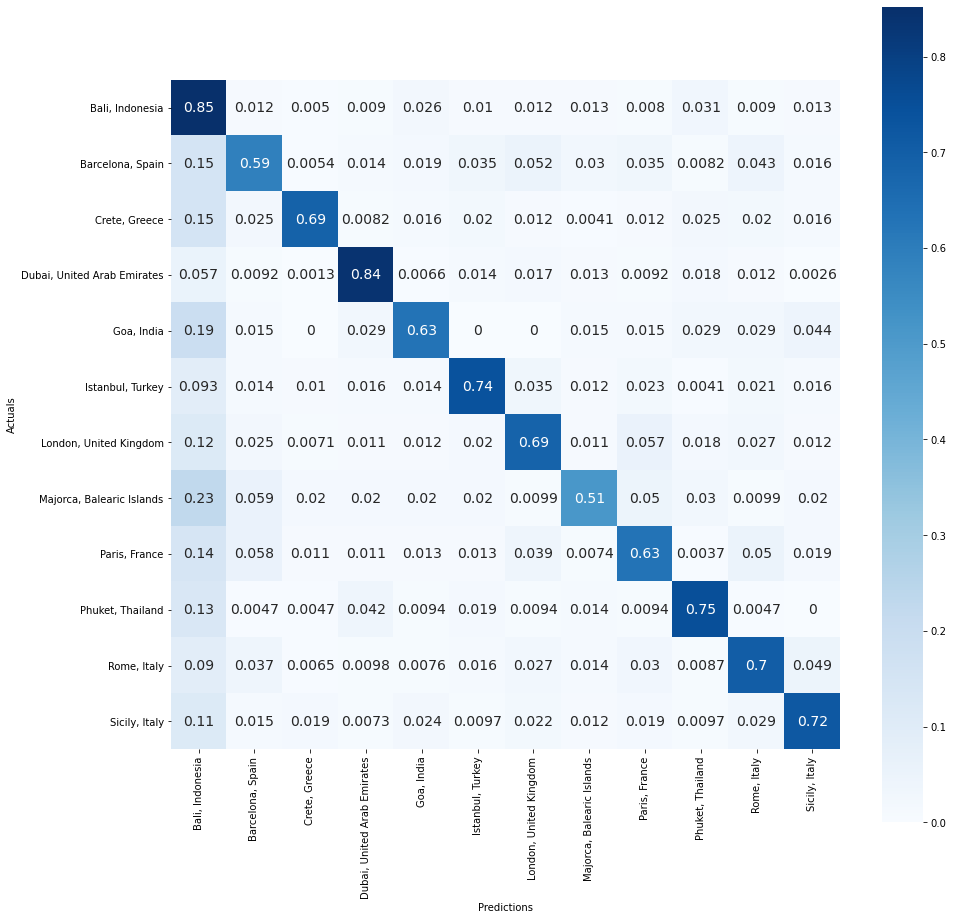


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.62      0.85      0.72      1001
           Barcelona, Spain       0.63      0.59      0.61       368
              Crete, Greece       0.81      0.69      0.74       244
Dubai, United Arab Emirates       0.91      0.84      0.87       760
                 Goa, India       0.34      0.63      0.44        68
           Istanbul, Turkey       0.81      0.74      0.78       485
     London, United Kingdom       0.76      0.69      0.72       563
  Majorca, Balearic Islands       0.42      0.51      0.46       101
              Paris, France       0.74      0.63      0.68       538
           Phuket, Thailand       0.65      0.75      0.70       212
                Rome, Italy       0.86      0.70      0.77       923
              Sicily, Italy       0.75      0.72      0.73       413

                   accuracy                           0.73      5676
             

In [92]:
bigram = CountVectorizer(analyzer='word',
                         stop_words=new_stopwords,
                         decode_error='ignore',
                         ngram_range=(2,2))
X_train_bg = bigram.fit_transform(X_train_preprocessed['lemmatized'])
X_test_bg = bigram.transform(X_test_preprocessed['lemmatized'])
nb_bg = MultinomialNB()
nb_bg.fit(X_train_bg.todense(),
          y_train,
          sample_weight=sample_weights)
evaluate_model(nb_bg, X_train_bg, X_test_bg)

**The bi-grams did well for the training recall, but not so great for the testing recall. Thus, this model is very overfit, and TF-IDF vectorization is the best vectorization strategy for this dataset.**

### Iteration 6: Try using a Random Forest Model
- The benefit of this is the ability to see feature importances and get more insight into how the model is working with the text data

In [93]:
vectorizer = TfidfVectorizer(analyzer='word',
                             stop_words=new_stopwords,
                             decode_error='ignore')
X_train_tfidf = vectorizer.fit_transform(X_train_preprocessed['lemmatized'])
X_test_tfidf = vectorizer.transform(X_test_preprocessed['lemmatized'])

In [94]:
rf = RandomForestClassifier(class_weight=weights_dict)
rf.fit(X_train_tfidf.todense(), y_train)

RandomForestClassifier(class_weight={'Bali, Indonesia': 0.4730974410269234,
                                     'Barcelona, Spain': 1.272304416050213,
                                     'Crete, Greece': 2.42864783910997,
                                     'Dubai, United Arab Emirates': 0.6448250397636901,
                                     'Goa, India': 6.732799525504152,
                                     'Istanbul, Turkey': 1.038373582144164,
                                     'London, United Kingdom': 0.8446056547619047,
                                     'Majorca, Balearic Islands': 5.359537299338999,
                                     'Paris, France': 0.8795521462885479,
                                     'Phuket, Thailand': 1.9129592180653858,
                                     'Rome, Italy': 0.4640462758564304,
                                     'Sicily, Italy': 1.1891368112298344})

Training Recall: 0.9774038673303088
Testing Recall: 0.8017970401691332

---------------

Train Confusion Matrix



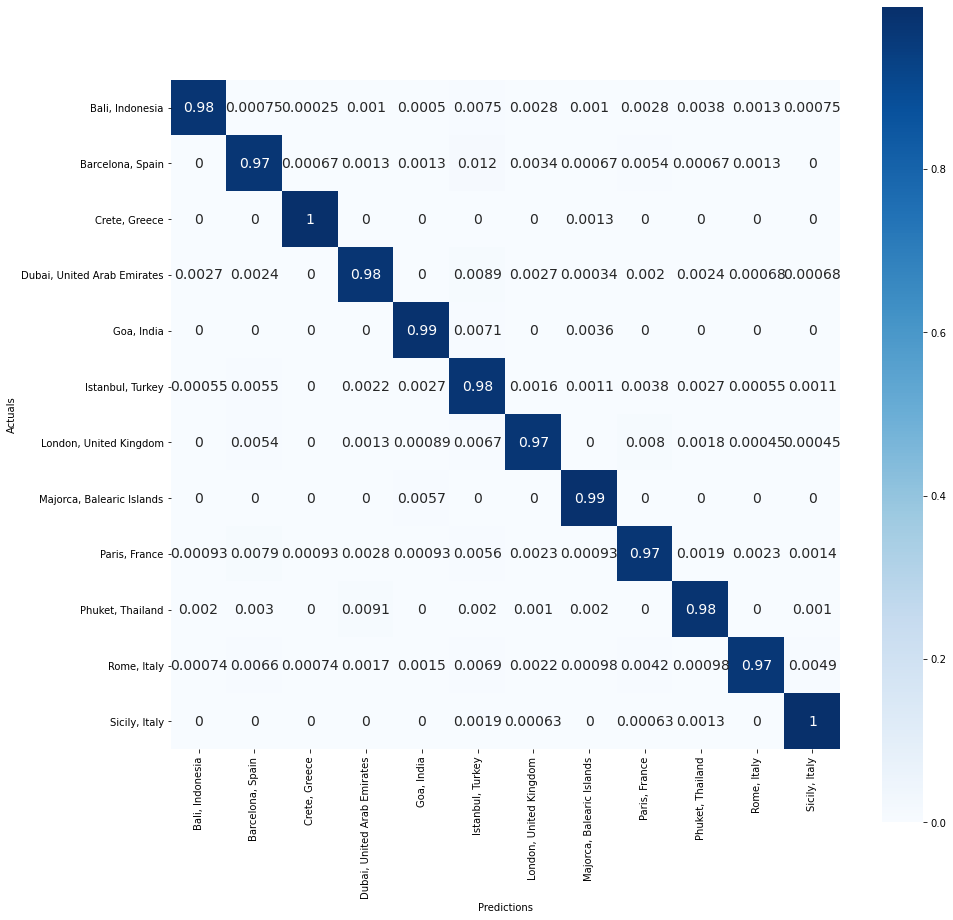

Test Confusion Matrix



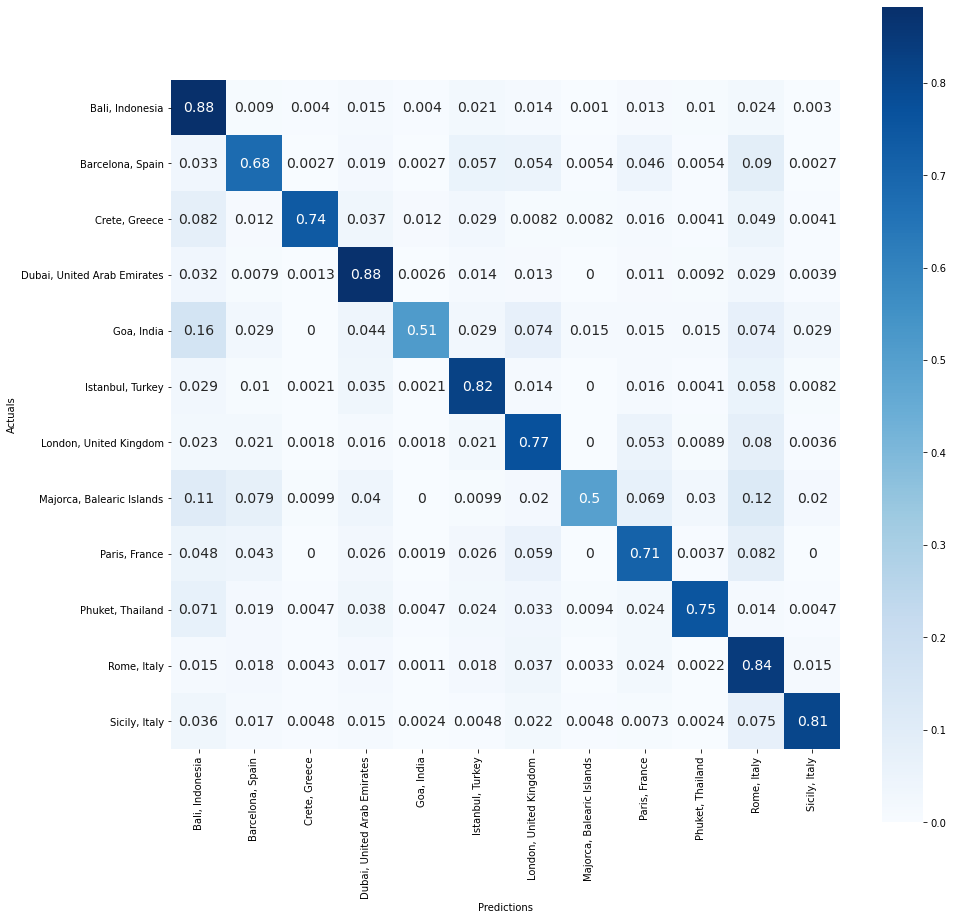


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.83      0.88      0.86      1001
           Barcelona, Spain       0.72      0.68      0.70       368
              Crete, Greece       0.92      0.74      0.82       244
Dubai, United Arab Emirates       0.86      0.88      0.87       760
                 Goa, India       0.69      0.51      0.59        68
           Istanbul, Turkey       0.78      0.82      0.80       485
     London, United Kingdom       0.75      0.77      0.76       563
  Majorca, Balearic Islands       0.79      0.50      0.61       101
              Paris, France       0.76      0.71      0.74       538
           Phuket, Thailand       0.82      0.75      0.78       212
                Rome, Italy       0.75      0.84      0.79       923
              Sicily, Italy       0.91      0.81      0.86       413

                   accuracy                           0.80      5676
             

In [95]:
evaluate_model(rf, X_train_tfidf, X_test_tfidf)

In [96]:
#Get feature importances
feat_imps = pd.Series(rf.feature_importances_,
                      index=vectorizer.get_feature_names())
feat_imps

aal         0.000007
abandon     0.000013
abant       0.000004
abbate      0.000025
abbey       0.000518
              ...   
فورميا      0.000002
مدينة       0.000005
من          0.000003
ميرتيتوا    0.000002
نقل         0.000006
Length: 7700, dtype: float64

In [98]:
top_20_feats = feat_imps.sort_values(ascending=False).head(20)
top_20_feats

tour          0.017898
palma         0.014945
palermo       0.014152
chania        0.012050
desert        0.011320
ubud          0.010929
etna          0.010312
heraklion     0.009814
catania       0.008415
taormina      0.008063
day           0.008000
colosseum     0.007397
city          0.007193
de            0.007174
island        0.006743
safari        0.006466
pmi           0.006243
turkey        0.006182
cappadocia    0.006050
vatican       0.005915
dtype: float64

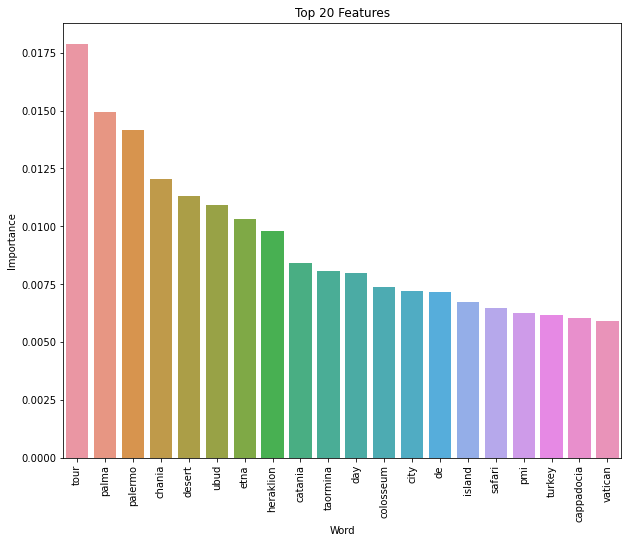

In [99]:
plt.figure(figsize=(10,8))
sns.barplot(x=top_20_feats.index, y=top_20_feats)
plt.title('Top 20 Features')
plt.xticks(rotation=90)
plt.ylabel('Importance')
plt.xlabel('Word')
plt.show()

**This model is also overfit, even though it still performs very well with the test set. Its performance is very good, but random forests have 2 major flaws that will affect this model for its specific use-case. 1) They are more computationally expensive than Naive Bayes models and 2) they use a greedy algorithm, meaning they often favor the bigger class (in this case it would predict Bali much more often than any of the other beach destinations. For these reasons I  still think iteration 3 is the best model so far.**

### Try out iteration 3 without lemmatization
- One last thing I would like to try is using the cleaned text data without lemmatizing it. I created the preprocessing function to give me this option.

In [100]:
X_train_cleaned = preprocess_df(pd.DataFrame(X_train, columns=['Attraction']),
                                'cleaned', lemmatize=False)
X_test_cleaned = preprocess_df(pd.DataFrame(X_test, columns=['Attraction']),
                               'cleaned', lemmatize=False)

,Attraction,cleaned
2092,The Colosseum and The Ancient City of Rome,the colosseum and the ancient city of rome
814,Paintball in Canggu/Bali,paintball in canggubali
1920,"9Hr Tour London Eye, Westminster Abbey and St ...",tour london eye westminster abbey and st paul...
348,Dubai 3h Sea escape: Swim! Tan! Sightsee!,dubai sea escape swim tan sightsee
3122,Private Bali Half Day Car Charter - Uluwatu Su...,private bali half day car charter uluwatu sun...
1313,Rooftop Pasta Making Class and Food Market Tou...,rooftop pasta making class and food market tou...
952,"Colosseum, Forum and Baroque Squares",colosseum forum and baroque squares
972,Gothic Quarter's deepest secrets & Sangria,gothic quarters deepest secrets sangria
1622,Private Half-Day Montserrat Tour in Afternoon ...,private halfday montserrat tour in afternoon ...
1036,Changing of the Guard Half-Day Private Walking...,changing of the guard halfday private walking ...


,Attraction,cleaned
302,Phuket City Tour Fullday,phuket city tour fullday
66,Phuket: Guided Fast Track Phuket Airport,phuket guided fast track phuket airport
208,Guided Montserrat Monastery Day Tour with Hot ...,guided montserrat monastery day tour with hot ...
3846,Private Pizza & Tiramisu Class at a Cesarina's...,private pizza tiramisu class at a cesarinas h...
111,Sierra Tramuntana: Mountain Tops and Cosy Vill...,sierra tramuntana mountain tops and cosy villages
1521,Bali Ubud Paon Cooking Class,bali ubud paon cooking class
277,Driver's license free boat rental,drivers license free boat rental
230,East bali tour,east bali tour
455,Private Tour: Istanbul Sightseeing Including M...,private tour istanbul sightseeing including mu...
1564,Catania Private Walking Tour,catania private walking tour


In [101]:
vectorizer = TfidfVectorizer(analyzer='word',
                             stop_words=new_stopwords,
                             decode_error='ignore')
X_train_tfidf = vectorizer.fit_transform(X_train_cleaned['cleaned'])
X_test_tfidf = vectorizer.transform(X_test_cleaned['cleaned'])

In [102]:
nb_cleaned = MultinomialNB()
nb_cleaned.fit(X_train_tfidf.todense(),
       y_train,
       sample_weight=sample_weights)

MultinomialNB()

Training Recall: 0.8598863586310179
Testing Recall: 0.8146582100070472

---------------

Train Confusion Matrix



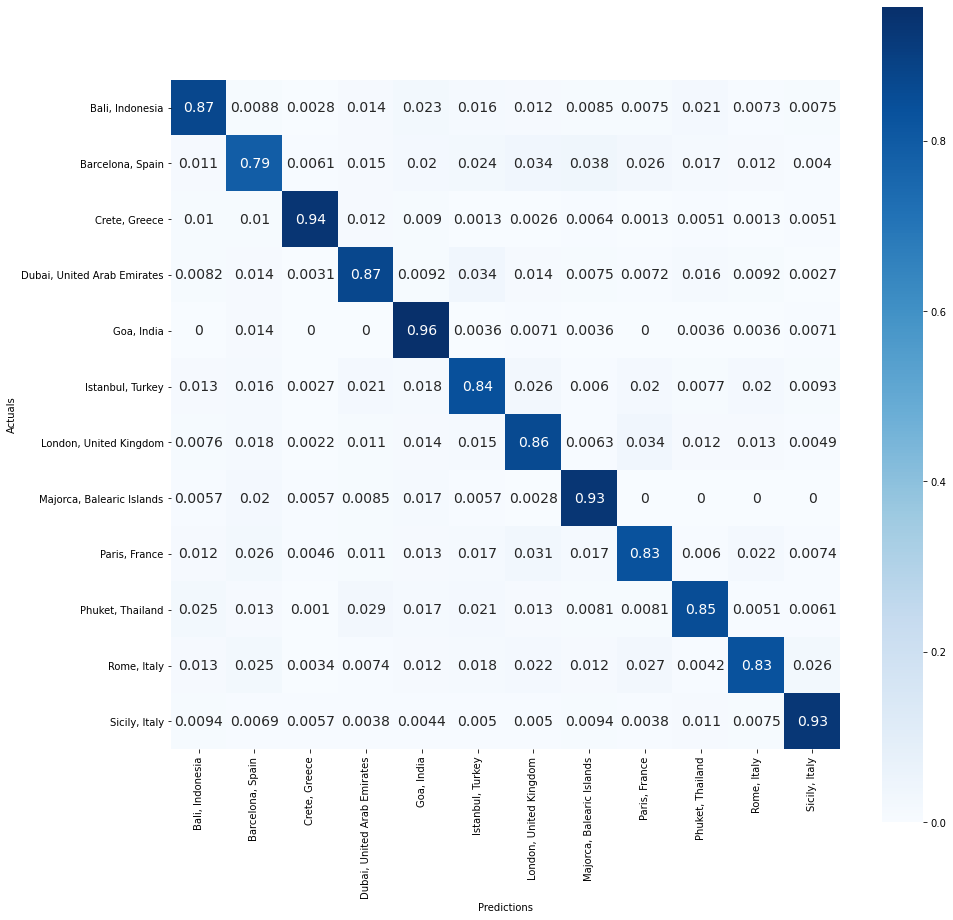

Test Confusion Matrix



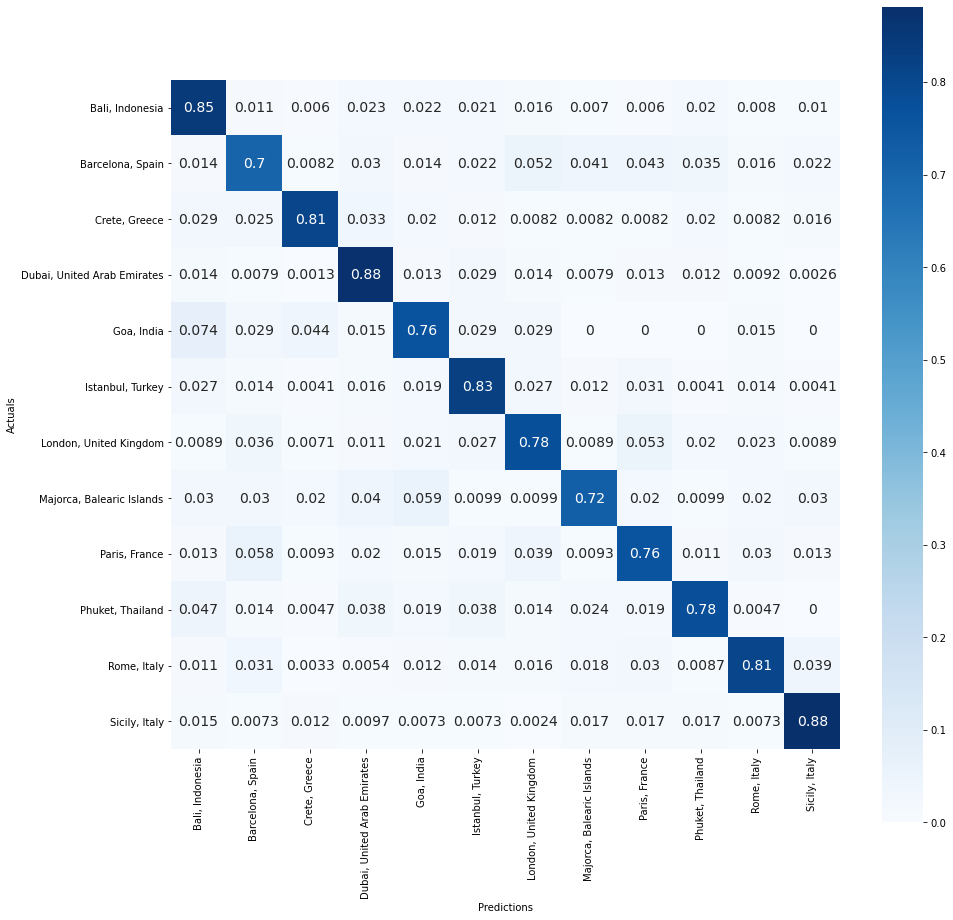


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.91      0.85      0.88      1001
           Barcelona, Spain       0.68      0.70      0.69       368
              Crete, Greece       0.85      0.81      0.83       244
Dubai, United Arab Emirates       0.88      0.88      0.88       760
                 Goa, India       0.35      0.76      0.48        68
           Istanbul, Turkey       0.79      0.83      0.81       485
     London, United Kingdom       0.81      0.78      0.79       563
  Majorca, Balearic Islands       0.49      0.72      0.59       101
              Paris, France       0.77      0.76      0.77       538
           Phuket, Thailand       0.67      0.78      0.72       212
                Rome, Italy       0.92      0.81      0.86       923
              Sicily, Italy       0.83      0.88      0.85       413

                   accuracy                           0.81      5676
             

In [104]:
evaluate_model(nb_cleaned, X_train_tfidf, X_test_tfidf)

**Ultimately, this model performed VERY similar to the lemmatized version. There are a couple of small differences that made me choose this version as my final model:**

1) The test recall score is a tiny bit higher for this model compared to the lemmatized version. Even though it is only one percent higher overall, the breakdown under each city has increased some of the smaller classes, such as Goa and Phuket. 

2) Lemmatization is more computationally expensive than omitting the lemmatization. It is a small difference, but should still be a consideration.

**Therefore, my final model is iteration 3 (Naive Bayes) without lemmatizing the text.**

In [123]:
# Pickle the best Naive Bayes Model
with open('/Users/tiaplagata/Documents/Flatiron/capstone-project/non_lemmatized_model',
          'wb') as f:
    pickle.dump(nb_cleaned, f, pickle.HIGHEST_PROTOCOL)

## Test out the model 
- I will ultimately use this model to tell people where they should travel based on what they want to do while on vacation. Let's look at some of the sample predictions this model would give them, using iteration 3 as our final model.

In [114]:
def preprocess_text(text):
    """
    Input raw text.
    Return preprocessed text.
    """
    
    preprocessed = text.lower()
    preprocessed = re.sub('[%s]' % re.escape(string.punctuation), '', preprocessed)
    preprocessed = re.sub('\w*\d\w*','', preprocessed)
        
    return [preprocessed]

In [115]:
raw_text = 'I want to go to the beach, go hiking and snorkeling'
preprocessed_text = preprocess_text(raw_text)
preprocessed_text

['i want to go to the beach go hiking and snorkeling']

In [116]:
nb_cleaned.predict(vectorizer.transform(preprocessed_text))

array(['Bali, Indonesia'], dtype='<U27')

In [118]:
preprocessed2 = preprocess_text('Go to historic museums')
print(preprocessed2)
nb_cleaned.predict(vectorizer.transform(preprocessed2))

['go to historic museums']


array(['Rome, Italy'], dtype='<U27')

In [119]:
preprocessed3 = preprocess_text('Wine tastings, long walks and dinners')
print(preprocessed3)
nb_cleaned.predict(vectorizer.transform(preprocessed3))

['wine tastings long walks and dinners']


array(['Crete, Greece'], dtype='<U27')

In [120]:
preprocessed4 = preprocess_text('Do yoga on the beach')
print(preprocessed4)
nb_cleaned.predict(vectorizer.transform(preprocessed4))

['do yoga on the beach']


array(['Goa, India'], dtype='<U27')

In [121]:
preprocessed5 = preprocess_text('Sunset cruises on a yacht with wine')
print(preprocessed5)
nb_cleaned.predict(vectorizer.transform(preprocessed5))

['sunset cruises on a yacht with wine']


array(['Crete, Greece'], dtype='<U27')

### Make this process into a pipeline

In [122]:
# Use OOP to get preprocessing steps into a pipeline
class PreprocessText():
    
    def fit(self, X, y=None, **fit_params):
        return self
        
    def transform(self, X, **transform_params):
        try:
            X = pd.DataFrame(X, columns=['Attraction'])
            X['cleaned'] = X['Attraction'].apply(lambda x: x.lower())
            X['cleaned'] = X['cleaned'].apply(lambda x: re.sub('[%s]' % re.escape(string.punctuation), '', x))
            X['cleaned'] = X['cleaned'].apply(lambda x: re.sub('\w*\d\w*','', x))
            
            X = X['cleaned']
        except:
            pass
        return X
    
class DenseTransformer():

    def fit(self, X, y=None, **fit_params):
        return self

    def transform(self, X, y=None, **fit_params):
        return X.todense()

In [124]:
# Test preprocessing class
prep = PreprocessText()
prep.transform(X_train)

2092           the colosseum and the ancient city of rome
814                               paintball in canggubali
1920     tour london eye westminster abbey and st paul...
348                   dubai  sea escape swim tan sightsee
3122    private bali half day car charter  uluwatu sun...
                              ...                        
1428                 barcelona city  la roca village tour
14      etna wine and alcantara tour  small groups fro...
3345                            fujiearah east coast tour
4210    early morning vatican museums sistine chapel s...
246             rafa nadal museum mallorca half day tour 
Name: cleaned, Length: 22703, dtype: object

In [125]:
pipe = Pipeline(steps=[
                ('TextPreprocessor', PreprocessText()),
                ('TFIDFVectorizer', TfidfVectorizer(analyzer='word',
                                                    stop_words=new_stopwords,
                                                    decode_error='ignore')),
                ('DenseTransformer', DenseTransformer()),
                ('NaiveBayes', MultinomialNB())])

In [126]:
pipe.fit(X_train,
         y_train, 
         **{'NaiveBayes__sample_weight': sample_weights})

Pipeline(steps=[('TextPreprocessor',
                 <__main__.PreprocessText object at 0x7fadc638ba30>),
                ('TFIDFVectorizer',
                 TfidfVectorizer(decode_error='ignore',
                                 stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...])),
                ('DenseTransformer',
                 <__main__.DenseTransformer object at 0x7fadc638b9d0>),
                ('NaiveBayes', MultinomialNB())])

In [127]:
pipe.score(X_test, y_test)

0.8146582100070472

In [128]:
pipe.predict(['I want to go snorkeling and tan on the beach'])

array(['Bali, Indonesia'], dtype='<U27')

In [129]:
pipe.predict(['Go out for drinks'])

array(['Barcelona, Spain'], dtype='<U27')

In [130]:
def evaluate_pipe(pipe, X_train, X_test):
    y_preds_train = pipe.predict(X_train)
    y_preds_test = pipe.predict(X_test)

    print('Training Recall:', recall_score(y_train, y_preds_train, average='weighted'))
    print('Testing Recall:', recall_score(y_test, y_preds_test, average='weighted'))
    print('\n---------------\n')
    print('Train Confusion Matrix\n')
    plot_conf_matrix(y_train, y_preds_train)
    print('Test Confusion Matrix\n')
    plot_conf_matrix(y_test, y_preds_test)
    print('\n----------------\n')
    print(classification_report(y_test, y_preds_test))

Training Recall: 0.8598863586310179
Testing Recall: 0.8146582100070472

---------------

Train Confusion Matrix



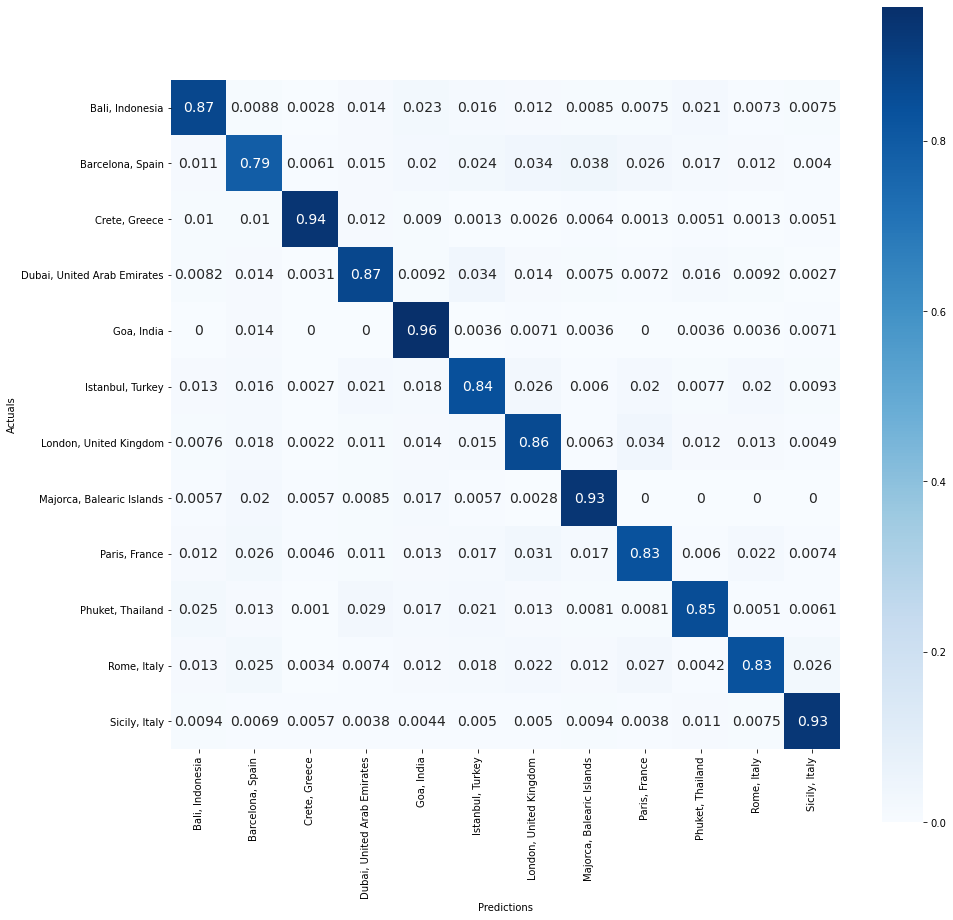

Test Confusion Matrix



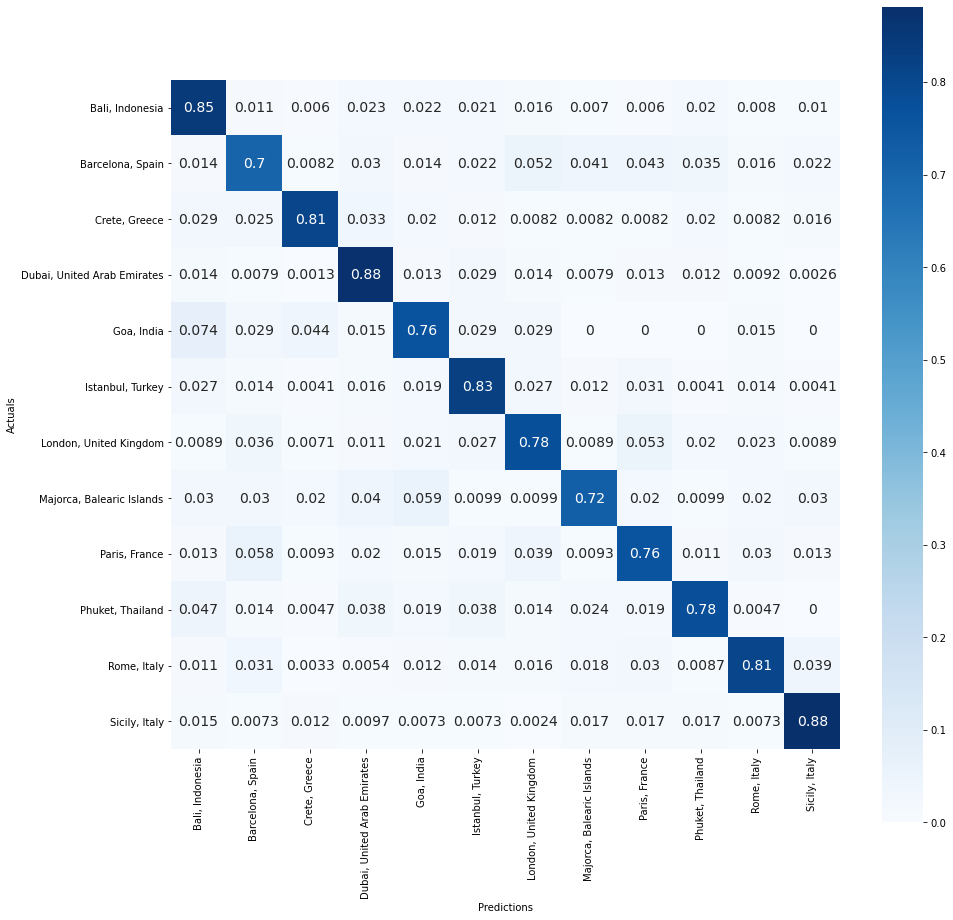


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.91      0.85      0.88      1001
           Barcelona, Spain       0.68      0.70      0.69       368
              Crete, Greece       0.85      0.81      0.83       244
Dubai, United Arab Emirates       0.88      0.88      0.88       760
                 Goa, India       0.35      0.76      0.48        68
           Istanbul, Turkey       0.79      0.83      0.81       485
     London, United Kingdom       0.81      0.78      0.79       563
  Majorca, Balearic Islands       0.49      0.72      0.59       101
              Paris, France       0.77      0.76      0.77       538
           Phuket, Thailand       0.67      0.78      0.72       212
                Rome, Italy       0.92      0.81      0.86       923
              Sicily, Italy       0.83      0.88      0.85       413

                   accuracy                           0.81      5676
             

In [131]:
evaluate_pipe(pipe, X_train, X_test)

In [132]:
# Pickle the Pipeline
with open('/Users/tiaplagata/Documents/Flatiron/capstone-project/final_pipeline',
          'wb') as f:
    pickle.dump(pipe, f, pickle.HIGHEST_PROTOCOL)

In [133]:
# Load pipe from pickled file to test
with open('/Users/tiaplagata/Documents/Flatiron/capstone-project/final_pipeline',
          'rb') as f:
    best_model_pipe = pickle.load(f)
best_model_pipe

Pipeline(steps=[('TextPreprocessor',
                 <__main__.PreprocessText object at 0x7fb0cb5699a0>),
                ('TFIDFVectorizer',
                 TfidfVectorizer(decode_error='ignore',
                                 stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...])),
                ('DenseTransformer',
                 <__main__.DenseTransformer object at 0x7fb0dcbee610>),
                ('NaiveBayes', MultinomialNB())])

In [184]:
best_model_pipe.predict(['I want to visit art galleries'])

array(['Paris, France'], dtype='<U27')

### Get top 2 predictions from best model
- In the dash app, it would be good to give someone a second prediction just in case they have already been to the first place the model predicts.

In [187]:
probas = best_model_pipe.predict_proba(['I want to visit art galleries'])
probas

array([[0.08062311, 0.10560993, 0.04660718, 0.03027719, 0.12294859,
        0.03850689, 0.16403276, 0.06665658, 0.18981578, 0.01453859,
        0.0769455 , 0.06343788]])

In [188]:
classes = best_model_pipe.classes_
classes

array(['Bali, Indonesia', 'Barcelona, Spain', 'Crete, Greece',
       'Dubai, United Arab Emirates', 'Goa, India', 'Istanbul, Turkey',
       'London, United Kingdom', 'Majorca, Balearic Islands',
       'Paris, France', 'Phuket, Thailand', 'Rome, Italy',
       'Sicily, Italy'], dtype='<U27')

In [212]:
# First Prediction
classes[probas.argmax()]

'Paris, France'

In [214]:
# Second Prediction
classes[np.argsort(probas)[:, 10]][0]

'London, United Kingdom'

**Amazing! Everything works and is ready to be put into a Dash app for its final use-case. Predicting where people should travel based on what they want to do on vacation!**